In [59]:
import os
from PIL import Image
import cv2
import pandas as pd
import numpy as np
import scipy
import random
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import Javascript, display, Markdown, clear_output

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from photutils import morphology
from astropy.io import fits
import imageio as iio

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

In [3]:
import pickle
def save(obj, file):
    pickle.dump(obj, open(SAVE + file, 'wb'))
def load(file):
    return pickle.load(open(SAVE + file, 'rb'))

In [2]:
DATA = "D:/images_training_rev1/images_training_rev1/"

In [4]:
def image_generator(pics, path=DATA, batch_size=30, rotate=False, size=100, save=False,
                    retrieve=False):
    '''
    Generate batches of numpy arrays from a list of image filenames.
    DATA is a global variable with the path to the image folder.  

    Output array has 4 dimensions in this order: 
        - Index of pictures in this batch 
        - x dimension of pixels in individual image 
        - y dimension of pixels in individual image
        - Color depth (R,G,B in this project, but it can scale)
    '''
    l = len(pics)
    batches = int(l/batch_size)
    leftover = l % batch_size
    for batch in range(batches):
        start = batch * batch_size
        this_batch = pics[start:start+batch_size]
        if rotate:
            yield np.array([ 
                            scipy.misc.imresize(
                                scipy.ndimage.rotate(
                                plt.imread(path + pic, format='jpg'),
                                reshape=False,
                                angle=random.randint(0,360, random_seed=RANDOM)
                                ),
                                size=size
                            )
                            
                            for pic in this_batch])
        else:
            yield np.array([ plt.imread(path + pic, format='jpg') for pic in this_batch])
    start = batches * batch_size
    this_batch = pics[start:start+leftover]
    yield np.array([ plt.imread(path + pic, format='jpg') for pic in this_batch])

In [5]:
SAVE = "D:/"

In [125]:

DIR_64_WIDE = "D:/processed_64x64_WIDE/"
images = [f for f in os.listdir(DATA) if os.path.isfile(os.path.join(DATA, f))]
print("There are " + '{:,}'.format(len(images)) + " images in the dataset.")
labels = pd.read_csv('D:/training_solutions_rev1.csv')
labels.GalaxyID = labels.GalaxyID.apply(lambda id: str(int(id)) + '.jpg')
print("There are " + '{:,}'.format(labels.shape[0]) + " truth values.")
print("There are " + '{:,}'.format(labels.shape[1]-1) + " categories for classification.")
desc = ['Smooth','Featured or disc','Star or artifact','Edge on','Not edge on','Bar through center','No bar','Spiral','No Spiral','No bulge','Just noticeable bulge','Obvious bulge','Dominant bulge','Odd Feature','No Odd Feature','Completely round','In between','Cigar shaped','Ring (Oddity)','Lens or arc (Oddity)','Disturbed (Oddity)','Irregular (Oddity)','Other (Oddity)','Merger (Oddity)','Dust lane (Oddity)','Rounded bulge','Boxy bulge','No bulge','Tightly wound arms','Medium wound arms','Loose wound arms','1 Spiral Arm','2 Spiral Arms','3 Spiral Arms','4 Spiral Arms','More than four Spiral Arms',"Can't tell"]

There are 61,578 images in the dataset.
There are 61,578 truth values.
There are 37 categories for classification.


In [13]:
save(labels, "labels.p")

In [105]:
labels = load("labels.p")
labels

,GalaxyID,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,100008.jpg,0.383147,0.616853,0.000000,0.000000,0.616853,0.038452,0.578401,0.418398,0.198455,...,0.000000,0.279952,0.138445,0.000000,0.000000,0.092886,0.000000,0.000000,0.0,0.325512
1,100023.jpg,0.327001,0.663777,0.009222,0.031178,0.632599,0.467370,0.165229,0.591328,0.041271,...,0.018764,0.000000,0.131378,0.459950,0.000000,0.591328,0.000000,0.000000,0.0,0.000000
2,100053.jpg,0.765717,0.177352,0.056931,0.000000,0.177352,0.000000,0.177352,0.000000,0.177352,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
3,100078.jpg,0.693377,0.238564,0.068059,0.000000,0.238564,0.109493,0.129071,0.189098,0.049466,...,0.000000,0.094549,0.000000,0.094549,0.189098,0.000000,0.000000,0.000000,0.0,0.000000
4,100090.jpg,0.933839,0.000000,0.066161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61573,999948.jpg,0.510379,0.489621,0.000000,0.059207,0.430414,0.000000,0.430414,0.226257,0.204157,...,0.000000,0.226257,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.226257
61574,999950.jpg,0.901216,0.098784,0.000000,0.000000,0.098784,0.000000,0.098784,0.000000,0.098784,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
61575,999958.jpg,0.202841,0.777376,0.019783,0.116962,0.660414,0.067245,0.593168,0.140022,0.520391,...,0.000000,0.000000,0.090673,0.049349,0.000000,0.067726,0.000000,0.000000,0.0,0.072296
61576,999964.jpg,0.091000,0.909000,0.000000,0.045450,0.863550,0.022452,0.841098,0.795330,0.068220,...,0.000000,0.068398,0.318132,0.408799,0.227464,0.408799,0.090668,0.023065,0.0,0.045334


In [109]:
labels.dtypes

GalaxyID      object
Class1.1     float64
Class1.2     float64
Class1.3     float64
Class2.1     float64
Class2.2     float64
Class3.1     float64
Class3.2     float64
Class4.1     float64
Class4.2     float64
Class5.1     float64
Class5.2     float64
Class5.3     float64
Class5.4     float64
Class6.1     float64
Class6.2     float64
Class7.1     float64
Class7.2     float64
Class7.3     float64
Class8.1     float64
Class8.2     float64
Class8.3     float64
Class8.4     float64
Class8.5     float64
Class8.6     float64
Class8.7     float64
Class9.1     float64
Class9.2     float64
Class9.3     float64
Class10.1    float64
Class10.2    float64
Class10.3    float64
Class11.1    float64
Class11.2    float64
Class11.3    float64
Class11.4    float64
Class11.5    float64
Class11.6    float64
dtype: object

In [107]:
type(labels)

pandas.core.frame.DataFrame

In [111]:
total_rows = 61578

In [112]:
percent_col1 = (labels.iloc[:, 1] > 0.5).sum() / total_rows * 100
percent_col2 = (labels.iloc[:, 2] > 0.5).sum() / total_rows * 100
percent_col3 = (labels.iloc[:, 3] > 0.5).sum() / total_rows * 100

In [113]:
print(percent_col1)

41.995517879762254


In [114]:
percent_col2

55.38504011172821

In [115]:
percent_col3

0.07145409074669525

Accuracy: 0.80
AUC: 0.91
Accuracy (Worse Model): 0.76
AUC (Worse Model): 0.86


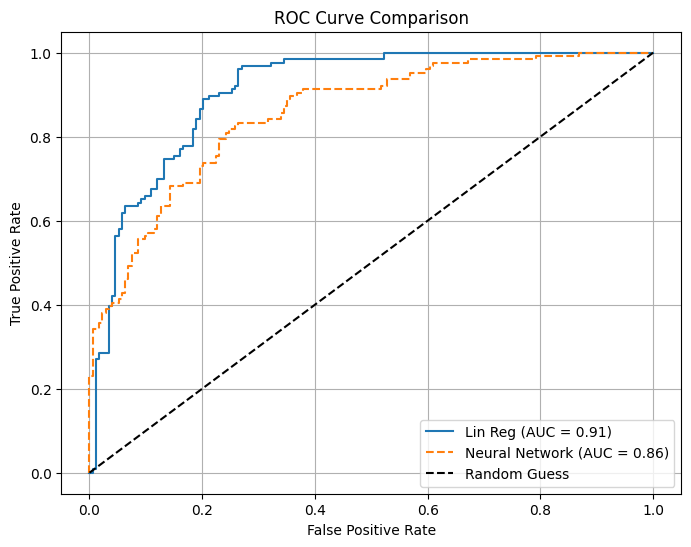

In [120]:
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, roc_auc_score, accuracy_score
import matplotlib.pyplot as plt

# Generate synthetic dataset
X, y = make_classification(n_samples=1000, n_features=10, n_informative=5, 
                           n_redundant=2, n_clusters_per_class=2, weights=[0.6, 0.4], random_state=42)

# Split the dataset into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train a Logistic Regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Make predictions
y_pred_prob = model.predict_proba(X_test)[:, 1]  # Predicted probabilities for the positive class
y_pred = (y_pred_prob > 0.5).astype(int)  # Threshold at 0.5

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Calculate AUC
auc = roc_auc_score(y_test, y_pred_prob)
print(f"AUC: {auc:.2f}")

# Simulate a worse model with 70% accuracy
noise = np.random.normal(0, 0.25, size=y_pred_prob.shape)
y_pred_prob_worse = np.clip(y_pred_prob * 0.6 + 0.4 * np.random.rand(len(y_pred_prob)), 0, 1)
y_pred_worse = (y_pred_prob_worse > 0.5).astype(int)
accuracy_worse = accuracy_score(y_test, y_pred_worse)
auc_worse = roc_auc_score(y_test, y_pred_prob_worse)
print(f"Accuracy (Worse Model): {accuracy_worse:.2f}")
print(f"AUC (Worse Model): {auc_worse:.2f}")

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
fpr_worse, tpr_worse, thresholds_worse = roc_curve(y_test, y_pred_prob_worse)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"Lin Reg (AUC = {auc:.2f})")
plt.plot(fpr_worse, tpr_worse, label=f"Neural Network (AUC = {auc_worse:.2f})", linestyle='--')
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve Comparison")
plt.legend(loc="lower right")
plt.grid()
plt.savefig("ROCcurve.jpg")
plt.show()


In [ ]:
title = 'Mean Confidence Level of All Classes'
plt.figure(title, figsize=(20, 5))
plt.suptitle(title, fontsize=20)
sns.barplot(x= labels.drop('GalaxyID', axis=1, inplace=False).mean().index, 
            y = labels.drop('GalaxyID', axis=1, inplace=False).mean().values)
plt.yticks(fontsize=16)
plt.xticks(fontsize=16, rotation=35, ha='right')
plt.show()

The highest confidence example for each answer / Feature.


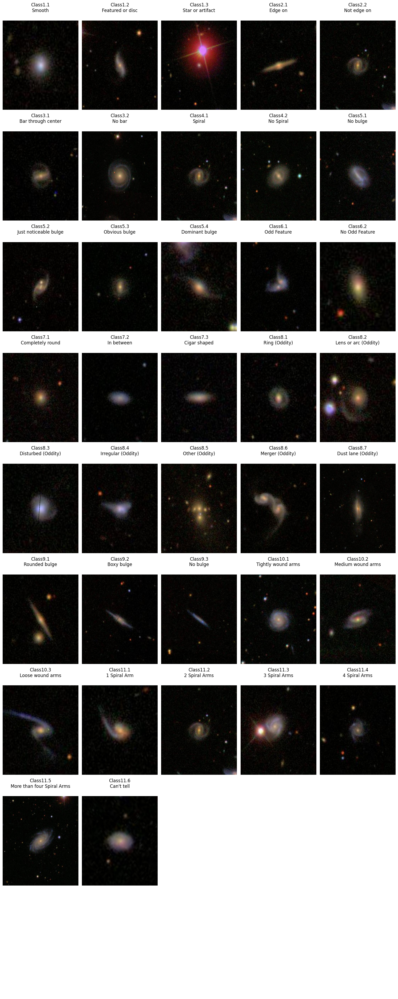

In [10]:
print("The highest confidence example for each answer / Feature.")
size = 15
fig = plt.figure('Image Examples', figsize=[size,size*10/4])
#plt.suptitle("Top Image for Each Feature", fontsize=20)
plt.axis('off')
plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')
for i, feature in enumerate(labels.columns[1:]):
    fig.add_subplot(9, 5, i+1)
    plt.title(feature + "\n" + desc[i]) 
    plt.axis('off')
    plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')

    file = labels.iloc[labels[feature].idxmax()].GalaxyID
    img = plt.imread(DATA + file, format='jpg')
    plt.imshow(img, aspect='auto')
    #plt.xlabel(str(i))
fig.tight_layout(pad=1.0)
plt.savefig("galaxies_overview.jpg")
plt.show()

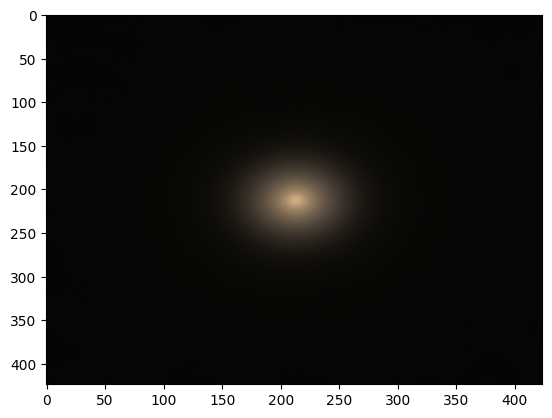

In [11]:
# get the average of 5000 images to see if the galaxy falls to the center

from PIL import Image
arr = np.array([Image.open(DATA
                            + pic).convert('RGB') for pic in labels.GalaxyID[0:5000]]) # take 5000 images
plt.imshow(np.average(arr, axis = 0).astype(int), aspect = 'auto') # round the floats to ints 

In [ ]:
arr.shape

Split the data into training, testing, validation. We don't know what to use the validation set for yet, but it's good to have.

In [38]:
RANDOM = 42
X, X_val, y, y_val = train_test_split(labels.GalaxyID, 
                                      labels[labels.columns[1:]],
                                      test_size = 0.20,
                                      random_state = RANDOM
                                     )
# split the X set into train and test sets

X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size = 0.20,
                                                    random_state = RANDOM
                                                   )

print("Training set: %d" % X_train.shape[0])
print("Testing set: %d" % X_test.shape[0])
print("Validation set: %d" % X_val.shape[0])

Training set: 39409
Testing set: 9853
Validation set: 12316


In [ ]:
X_train

In [ ]:
ig = image_generator(X_train, batch_size = 3000)

In [ ]:
# define a function that returns a ther center pixel
def center_pixel(pic):
    return pic[:, int(pic.shape[1]/2), int(pic.shape[2] / 2),:]

In [ ]:
init = False
for step in ig:
    if not init:
        centers_train = center_pixel(step)
        init = True
    else:
        centers_train = np.append(centers_train, center_pixel(step), axis = 0)


In [ ]:
centers_train.shape # we have the centers of 39409 

In [ ]:
save(centers_train, 'centers_train.p')

In [ ]:
init = False
for step in image_generator(X_test, batch_size = 3000):
    if not init:
        centers_test = center_pixel(step)
        init = True
    else:
        centers_test = np.append(centers_test, center_pixel(step), axis = 0)

In [ ]:
centers_test.shape

In [ ]:
# define a funciton that returns the average pixel
def average_color(pic):
    return np.sum(pic, axis=(1,2)) / (pic.shape[1] * pic.shape[2])

In [ ]:
init = False
for step in image_generator(X_train, batch_size = 3000):
    if not init:
        averages_train = average_color(step)
        init = True
    else:
        averages_train = np.append(averages_train, average_color(step), axis = 0)

In [ ]:
init = False
for step in image_generator(X_test, batch_size = 3000):
    if not init:
        averages_test = average_color(step)
        init = True
    else:
        averages_test = np.append(averages_test, average_color(step), axis = 0)

In [ ]:
averages_train.shape

In [ ]:
averages_test.shape

In [ ]:
# define a MSE function
def RMSE(pred, truth):
    # element-wise RMSE score
    return np.sqrt(np.mean(np.square(np.array(pred).flatten() - np.array(truth).flatten())))

In [ ]:
# preform linear regression
lr = LinearRegression()
lr.fit(centers_train, y_train)
pred = lr.predict(centers_test) # predict with the test set
print(pred.shape)
print("The RMSE with using center is %.4f" % RMSE(pred, y_test))

In [ ]:
y_train.iloc[:,3]

In [ ]:
# we fit using statsmodels so we can get a summary on our fit...
# but statsmodels doesn't have a multivariate regression model, so we just do each column individually
import statsmodels.api as sm
centers_train_with_constants = sm.add_constant(centers_train)
centers_test_with_constants = sm.add_constant(centers_test)

def fit_MVR(X_train, Y_train, X_test):
    predictions = []

    for i in range(Y_train.shape[1]):
        model = sm.OLS(Y_train.iloc[:, i], X_train).fit()
        pred = model.predict(X_test)
        predictions.append(pred)
    return np.column_stack(predictions)

pred_sm = fit_MVR(centers_train_with_constants, y_train, centers_test_with_constants)
print(pred.shape)
print("The RMSE with using statsmodels is %.4f" % RMSE(pred_sm, y_test))

In [ ]:
# do the same with average pixel
# preform linear regression
lr = LinearRegression()
lr.fit(averages_train, y_train)
pred = lr.predict(averages_test) # predict with the test set
print(pred.shape)
print("The RMSE with using center is %.4f" % RMSE(pred, y_test))

We can use `phoutils` to extract the gini index of each image

In [ ]:


def fits_generator(pics, path = DATA, batch_size = 30, rotate = False, size = 100, save = False,
                   retreive = False):
    l = len(pics)
    batches = int(l/batch_size)
    leftover = l % batch_size
    for batch in range(batches):
        start = batch * batch_size
        this_batch = pics[start:start+batch_size]
        yield np.array([fits.PrimaryHDU(iio.imread(path + pic)) for pic in this_batch])
    start = batches * batch_size
    this_batch = pics[start:start+leftover]
    
    yield np.array([fits.PrimaryHDU(iio.imread(path+pic)) for pic in this_batch])


In [ ]:
fits_gen = fits_generator(X_train, batch_size = 3000)
init = False
gini_train = []

for step in fits_gen:
    print(step.shape)
    gini_train.extend([morphology.gini(hdu.data) for hdu in step])

gini_train = np.array(gini_train)

In [ ]:
# for test
fits_gen = fits_generator(X_test, batch_size = 3000)
init = False
gini_test = []

for step in fits_gen:
    print(step.shape)
    gini_test.extend([morphology.gini(hdu.data) for hdu in step])
gini_test = np.array(gini_test)

In [ ]:
lr = LinearRegression()
lr.fit(gini_train.reshape(-1,1), y_train)
pred = lr.predict(gini_test.reshape(-1,1))
pred.shape
print("The RMSE of fitting using gini is %.4f" % RMSE(pred, y_test))

The gini index loses against the average and the center pixel benchmark?

In [37]:
from astropy.visualization import simple_norm
from astropy.modeling.models import Sersic2D
from astropy.convolution import convolve, Gaussian2DKernel
from photutils.segmentation import detect_threshold, detect_sources
import time
import statmorph
%matplotlib inline

In [39]:
X_train

34545    605348.jpg
48223    802303.jpg
6475     195558.jpg
8861     230809.jpg
53973    887291.jpg
            ...    
12854    290387.jpg
34631    606584.jpg
43883    740261.jpg
8570     226387.jpg
2280     134285.jpg
Name: GalaxyID, Length: 39409, dtype: object

C:\Users\William\AppData\Local\Temp\ipykernel_49492\3637249213.py:2: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + X_train.iloc[0])


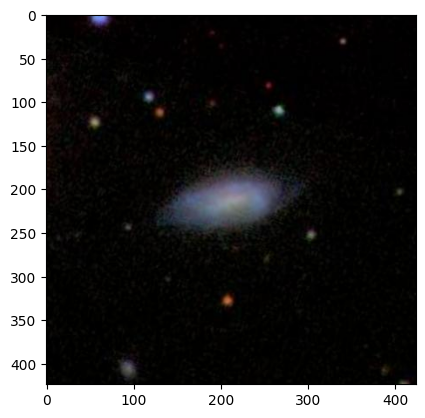

In [40]:
# trying to convert the .jpg images to .fits so that we can use it with astro libraries
img = iio.imread(DATA + X_train.iloc[0])
plt.imshow(img)

In [42]:
r, g, b = img[:, :, 0], img[:, :, 1], img[:, :, 2]

In [43]:
red = fits.PrimaryHDU(data = r)

green = fits.PrimaryHDU(data = g)

blue = fits.PrimaryHDU(data = g)


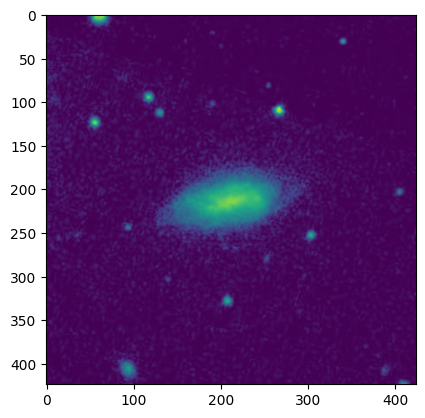

In [44]:
%matplotlib inline
plt.imshow(blue.data)
plt.show()

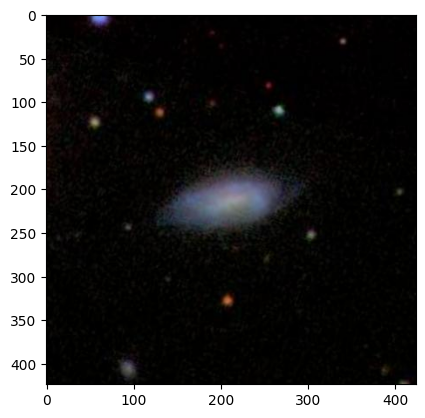

In [45]:
plt.imshow(img)
plt.show()

In [ ]:
%matplotlib notebook

In [46]:
def blues_generator(pics, path = DATA, batch_size = 30, rotate = False, size = 100, save = False,
                   retreive = False):
    l = len(pics)
    batches = int(l/batch_size)
    leftover = l % batch_size
    for batch in range(batches):
        start = batch * batch_size
        this_batch = pics[start:start+batch_size]
        yield np.array([fits.PrimaryHDU(iio.imread(path+pic)[:,:,2]) for pic in this_batch])
    start = batches * batch_size
    this_batch = pics[start:start+leftover]
    
    yield np.array([fits.PrimaryHDU(iio.imread(path+pic)[:,:,2]) for pic in this_batch])

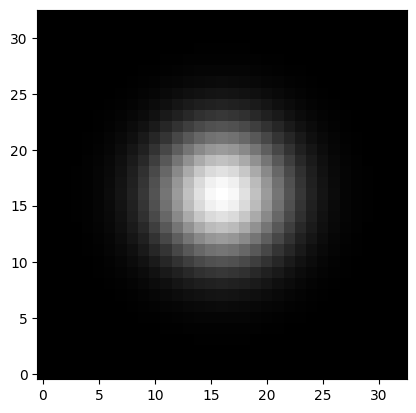

In [47]:
# convoluting with a psf
kernel = Gaussian2DKernel(4)
kernel.normalize()
psf = kernel.array
plt.imshow(psf, origin = 'lower', cmap='gray')
plt.show()

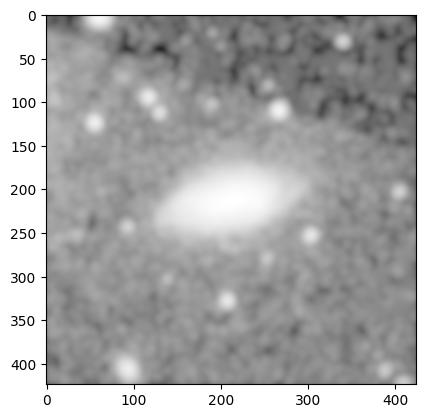

In [48]:
image = convolve(blue.data, psf)
plt.imshow(image, cmap='gray',
           norm = simple_norm(image, stretch='log', log_a = 10000))
plt.show()

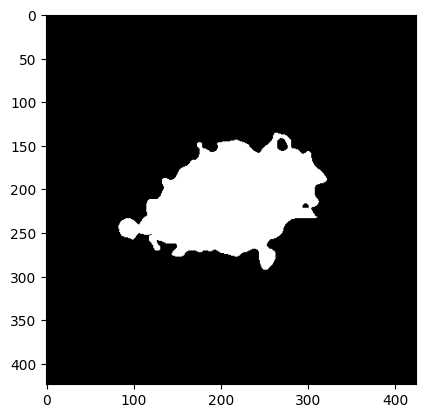

In [49]:
# create segmentation map
threshold = detect_threshold(blue.data, 1.5)
npixels = 10000
convolved_image = convolve(blue.data, psf)
segmap = detect_sources(convolved_image, threshold, npixels)
plt.imshow(segmap, cmap='gray')
plt.show()

In [50]:
# run statmorph
start = time.time()
source_morph = statmorph.source_morphology(
    blue.data, segmap, gain=1e5, psf = psf)
print('Time: %g s.' % (time.time() - start))

C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)


Time: 4.1183 s.


In [51]:
morph = source_morph[0]

In [52]:
print('BASIC MEASUREMENTS (NON-PARAMETRIC)')
print('xc_centroid =', morph.xc_centroid)
print('yc_centroid =', morph.yc_centroid)
print('ellipticity_centroid =', morph.ellipticity_centroid)
print('elongation_centroid =', morph.elongation_centroid)
print('orientation_centroid =', morph.orientation_centroid)
print('xc_asymmetry =', morph.xc_asymmetry)
print('yc_asymmetry =', morph.yc_asymmetry)
print('ellipticity_asymmetry =', morph.ellipticity_asymmetry)
print('elongation_asymmetry =', morph.elongation_asymmetry)
print('orientation_asymmetry =', morph.orientation_asymmetry)
print('rpetro_circ =', morph.rpetro_circ)
print('rpetro_ellip =', morph.rpetro_ellip)
print('rhalf_circ =', morph.rhalf_circ)
print('rhalf_ellip =', morph.rhalf_ellip)
print('r20 =', morph.r20)
print('r80 =', morph.r80)
print('Gini =', morph.gini)
print('M20 =', morph.m20)
print('F(G, M20) =', morph.gini_m20_bulge)
print('S(G, M20) =', morph.gini_m20_merger)
print('sn_per_pixel =', morph.sn_per_pixel)
print('C =', morph.concentration)
print('A =', morph.asymmetry)
print('S =', morph.smoothness)
print()
print('SERSIC MODEL')
print('sersic_amplitude =', morph.sersic_amplitude)
print('sersic_rhalf =', morph.sersic_rhalf)
print('sersic_n =', morph.sersic_n)
print('sersic_xc =', morph.sersic_xc)
print('sersic_yc =', morph.sersic_yc)
print('sersic_ellip =', morph.sersic_ellip)
print('sersic_theta =', morph.sersic_theta)
print('sersic_chi2_dof =', morph.sersic_chi2_dof)
print()
print('OTHER')
print('sky_mean =', morph.sky_mean)
print('sky_median =', morph.sky_median)
print('sky_sigma =', morph.sky_sigma)
print('flag =', morph.flag)
print('flag_sersic =', morph.flag_sersic)

BASIC MEASUREMENTS (NON-PARAMETRIC)
xc_centroid = 209.52799956250684
yc_centroid = 214.00379681567475
ellipticity_centroid = 0.46926206471197385
elongation_centroid = 1.884169066334612
orientation_centroid = -0.23426310258947858
xc_asymmetry = 210.26176233486507
yc_asymmetry = 213.75924450301488
ellipticity_asymmetry = 0.46935988629848546
elongation_asymmetry = 1.8845164060900619
orientation_asymmetry = -0.23430934189902525
rpetro_circ = 82.11771809511907
rpetro_ellip = 87.27657102216479
rhalf_circ = 64.81283273072569
rhalf_ellip = 80.17493530253206
r20 = 21.918807981255576
r80 = 75.55485018958963
Gini = 0.4022218279669616
M20 = -1.3803579713009217
F(G, M20) = -1.0124138774520013
S(G, M20) = -0.1206701483235362
sn_per_pixel = 17.741031952023512
C = 2.687227083693193
A = 0.18864745665891303
S = 0.09042262260924598

SERSIC MODEL
sersic_amplitude = 74.4884426335112
sersic_rhalf = 49.50535845601444
sersic_n = 0.503273303329967
sersic_xc = 209.5864037224027
sersic_yc = 213.98790597592665
se

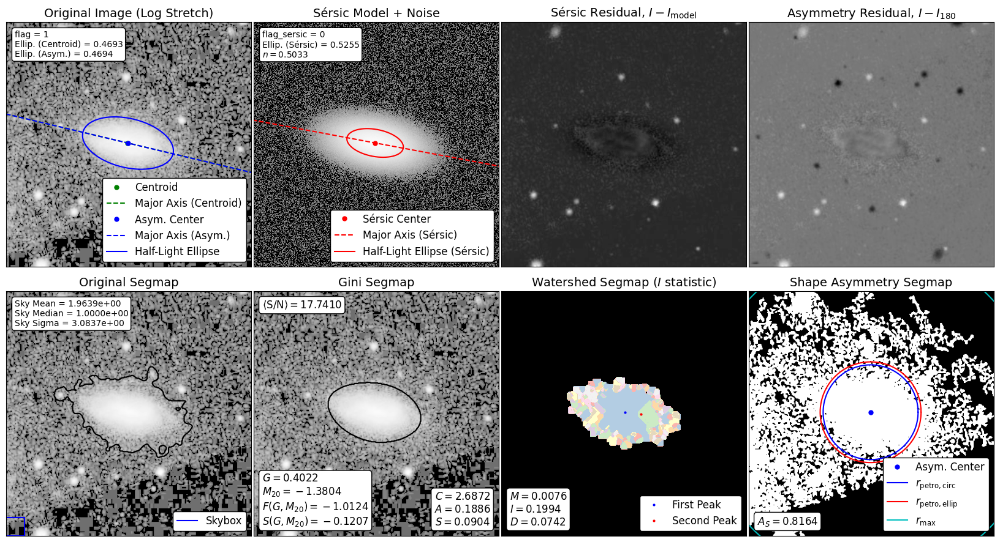

In [32]:
# visualize morphological measurements
from statmorph.utils.image_diagnostics import make_figure
fig = make_figure(morph)
plt.show()

In [62]:
X_train.shape

(39409,)

In [61]:
X_train_small = X_train.sample(n=1000, random_state=42)

In [76]:
X_test_small = X_test.sample(n=500, random_state = 42)
X_test_small

17060    351159.jpg
51703    853177.jpg
12097    278841.jpg
29947    539370.jpg
50763    839540.jpg
            ...    
34346    602684.jpg
25701    475728.jpg
18791    376078.jpg
21736    417513.jpg
24824    462575.jpg
Name: GalaxyID, Length: 500, dtype: object

In [77]:
y_test_small = y_test.sample(n = 500, random_state = 42)
y_test_small

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
17060,0.024520,0.963071,0.012409,0.026969,0.936102,0.330308,0.605794,0.907544,0.028559,0.000000,...,0.000000,0.102257,0.649527,0.155759,0.000000,0.593751,0.260038,0.000000,0.000000,0.053755
51703,0.194530,0.798894,0.006577,0.163689,0.635205,0.545913,0.089292,0.000000,0.635205,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
12097,0.127237,0.872544,0.000219,0.045788,0.826756,0.159768,0.666987,0.536206,0.290549,0.000000,...,0.000000,0.214451,0.235774,0.085981,0.059881,0.085305,0.000000,0.254661,0.000000,0.136359
29947,0.061000,0.909000,0.030000,0.120897,0.788103,0.423999,0.364104,0.758155,0.029948,0.060684,...,0.090673,0.636850,0.121305,0.000000,0.060652,0.121305,0.000000,0.000000,0.030326,0.545872
50763,0.446486,0.496328,0.057186,0.000000,0.496328,0.000000,0.496328,0.000000,0.496328,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34346,0.431338,0.568662,0.000000,0.055021,0.513641,0.000000,0.513641,0.047819,0.465822,0.065692,...,0.055021,0.030147,0.000000,0.017672,0.000000,0.000000,0.000000,0.000000,0.000000,0.047819
25701,0.288806,0.685780,0.025414,0.249164,0.436616,0.000000,0.436616,0.116114,0.320502,0.000000,...,0.000000,0.116114,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.116114
18791,0.353014,0.619664,0.027322,0.000000,0.619664,0.000000,0.619664,0.000000,0.619664,0.413316,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
21736,0.033586,0.966122,0.000292,0.000000,0.966122,0.809212,0.156910,0.353762,0.612360,0.000000,...,0.000000,0.149786,0.166146,0.037830,0.000000,0.230984,0.122778,0.000000,0.000000,0.000000


In [ ]:
# %%capture output
#it's going to take a while to extract all the features of each galaxy but we will try to do it 
blues = blues_generator(X_train_small, batch_size = 3000)
init = False
features_list = []
npixels = 5

for step in blues:
    print(step.shape)
    for blue_ in step:
        convolved_image = convolve(blue_.data, psf)
        threshold = detect_threshold(blue_.data, 1.5)
        segmap = detect_sources(convolved_image, threshold, npixels)
        source_morphs = statmorph.source_morphology(
            blue_.data, segmap, gain=1e5, psf=psf)
        morph = source_morphs[0]
        features = {
            "gini":morph.gini,
            "m20":morph.m20,
            "concentration": morph.concentration,
            "asymmetry": morph.asymmetry,
            "smoothness": morph.smoothness
        }

        features_list.append(features)

df = pd.DataFrame(features_list)

save(df, 'galaxy_features.p')

C:\Users\William\AppData\Local\Temp\ipykernel_49492\3349721548.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  yield np.array([fits.PrimaryHDU(iio.imread(path+pic)[:,:,2]) for pic in this_batch])


(1000,)


C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\sta

In [ ]:
# %%capture output
#it's going to take a while to extract all the features of each galaxy but we will try to do it 
blues = blues_generator(X_test_small, batch_size = 3000)
init = False
features_list = []
npixels = 5

for step in blues:
    print(step.shape)
    for blue_ in step:
        convolved_image = convolve(blue_.data, psf)
        threshold = detect_threshold(blue_.data, 1.5)
        segmap = detect_sources(convolved_image, threshold, npixels)
        source_morphs = statmorph.source_morphology(
            blue_.data, segmap, gain=1e5, psf=psf)
        morph = source_morphs[0]
        features = {
            "gini":morph.gini,
            "m20":morph.m20,
            "concentration": morph.concentration,
            "asymmetry": morph.asymmetry,
            "smoothness": morph.smoothness
        }

        features_list.append(features)

df_test = pd.DataFrame(features_list)

save(df_test, 'galaxy_features_test.p')

C:\Users\William\AppData\Local\Temp\ipykernel_49492\3349721548.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  yield np.array([fits.PrimaryHDU(iio.imread(path+pic)[:,:,2]) for pic in this_batch])


(500,)


C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\statmorph.py:691: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_mean2 - local_mean**2)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\statmorph\sta

In [92]:
features_test = load('galaxy_features_test.p')

In [93]:
features_list = load('galaxy_features.p')

In [83]:
X_train_small

43415    733634.jpg
11446    269734.jpg
38074    656016.jpg
12519    285154.jpg
4151     162116.jpg
            ...    
58576    955788.jpg
36786    637718.jpg
56576    926387.jpg
46704    780630.jpg
13304    297478.jpg
Name: GalaxyID, Length: 1000, dtype: object

In [70]:
y_train_small = y_train.sample(n=1000, random_state=42)
y_train_small

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
43415,0.111353,0.821414,0.067233,0.000000,0.821414,0.131726,0.689688,0.625655,0.195759,0.540490,...,0.000000,0.138896,0.324715,0.162045,0.0,0.069517,0.208552,0.069517,0.069517,0.208552
11446,0.873036,0.126964,0.000000,0.000000,0.126964,0.088343,0.038621,0.000000,0.126964,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
38074,0.558781,0.441219,0.000000,0.330914,0.110305,0.000000,0.110305,0.000000,0.110305,0.000000,...,0.134777,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
12519,0.450652,0.549348,0.000000,0.000000,0.549348,0.000000,0.549348,0.133364,0.415984,0.000000,...,0.000000,0.000000,0.133364,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.133364
4151,0.790063,0.122202,0.087735,0.000000,0.122202,0.000000,0.122202,0.000000,0.122202,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58576,0.067239,0.929923,0.002838,0.929923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.039141,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
36786,0.395442,0.581408,0.023150,0.000000,0.581408,0.307908,0.273500,0.433865,0.147543,0.000000,...,0.000000,0.000000,0.000000,0.433865,0.0,0.313967,0.000000,0.000000,0.000000,0.119897
56576,0.803512,0.151809,0.044679,0.000000,0.151809,0.000000,0.151809,0.000000,0.151809,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
46704,0.613154,0.363164,0.023681,0.000000,0.363164,0.000000,0.363164,0.000000,0.363164,0.363164,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000


In [94]:
features_list

,gini,m20,concentration,asymmetry,smoothness
0,0.559259,-0.862112,2.822868,-0.419338,-1.589059
1,0.468756,-0.952655,1.852403,0.559629,0.006060
2,0.557681,-1.065282,2.977650,-0.066868,-0.694662
3,0.491155,-1.060912,2.352694,-0.300552,-0.354405
4,0.471582,-1.680696,2.718848,-0.013889,-0.233019
...,...,...,...,...,...
995,0.585356,-1.506458,2.274310,-0.170692,0.000000
996,0.389637,-1.027664,2.054474,0.179734,0.000000
997,0.455034,-0.944513,2.174917,0.356386,0.023925
998,0.570851,-0.920573,2.951255,-0.089026,-0.447912


In [95]:
len(features_list)

1000

In [97]:
y_test_small

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
17060,0.024520,0.963071,0.012409,0.026969,0.936102,0.330308,0.605794,0.907544,0.028559,0.000000,...,0.000000,0.102257,0.649527,0.155759,0.000000,0.593751,0.260038,0.000000,0.000000,0.053755
51703,0.194530,0.798894,0.006577,0.163689,0.635205,0.545913,0.089292,0.000000,0.635205,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
12097,0.127237,0.872544,0.000219,0.045788,0.826756,0.159768,0.666987,0.536206,0.290549,0.000000,...,0.000000,0.214451,0.235774,0.085981,0.059881,0.085305,0.000000,0.254661,0.000000,0.136359
29947,0.061000,0.909000,0.030000,0.120897,0.788103,0.423999,0.364104,0.758155,0.029948,0.060684,...,0.090673,0.636850,0.121305,0.000000,0.060652,0.121305,0.000000,0.000000,0.030326,0.545872
50763,0.446486,0.496328,0.057186,0.000000,0.496328,0.000000,0.496328,0.000000,0.496328,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34346,0.431338,0.568662,0.000000,0.055021,0.513641,0.000000,0.513641,0.047819,0.465822,0.065692,...,0.055021,0.030147,0.000000,0.017672,0.000000,0.000000,0.000000,0.000000,0.000000,0.047819
25701,0.288806,0.685780,0.025414,0.249164,0.436616,0.000000,0.436616,0.116114,0.320502,0.000000,...,0.000000,0.116114,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.116114
18791,0.353014,0.619664,0.027322,0.000000,0.619664,0.000000,0.619664,0.000000,0.619664,0.413316,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
21736,0.033586,0.966122,0.000292,0.000000,0.966122,0.809212,0.156910,0.353762,0.612360,0.000000,...,0.000000,0.149786,0.166146,0.037830,0.000000,0.230984,0.122778,0.000000,0.000000,0.000000


In [96]:
# preform linear regression
lr = LinearRegression()
lr.fit(features_list, y_train_small)
pred = lr.predict(features_test) # predict with the test set
print(pred.shape)
print("The RMSE with using statsmorph is %.4f" % RMSE(pred, y_test_small))

(500, 37)
The RMSE with using statsmorph is 0.1601


In [ ]:
df = pd.DataFrame(features_list)
df.shape
df

In [ ]:
blues = blues_generator(X_train, batch_size = 1)
one = next(blues)
plt.imshow(one[0].data)
plt.show()

Finally let's get to the CNN. Last time we preprocessed the data from `424x424` to `128x128`. Let's try to not do that here

<IPython.core.display.Javascript object>

### The highest confidence example for each answer / feature - 64x64 color.

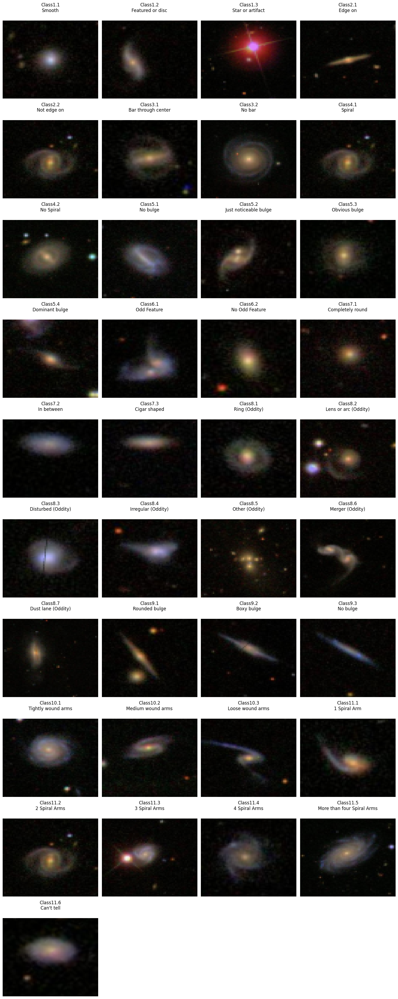

In [37]:
# explore processed images first 64x64 with 20% padding
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))
display(Markdown("### The highest confidence example for each answer / feature - 64x64 color."))
size = 15
fig = plt.figure('Image Examples', figsize=[size,size*10/4])
#plt.suptitle("Top Image for Each Feature", fontsize=20)
plt.axis('off')
plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')
for i, feature in enumerate(labels.columns[1:]):
    fig.add_subplot(10, 4, i+1)
    plt.title(feature + "\n" + desc[i]) 
    plt.axis('off')
    plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')
    file = labels.iloc[labels[feature].idxmax()].GalaxyID
    img = plt.imread(DIR_64_WIDE + file.replace('jpg','png'), format='png')
    plt.imshow(img, aspect='auto', cmap='gray')
    #plt.xlabel(str(i))
fig.tight_layout(pad=1.0)
plt.show()

In [168]:
# repeat train_test_split with png images
labels = load('labels.p')

RANDOM = 42

# I skipped the validation split to get more training data. In the competition, 
# the data is validated against a withheld dataset which I do not have. 

X_train, X_test, y_train, y_test = train_test_split(labels.GalaxyID.apply(lambda pic: pic.replace('jpg', 'png')), 
                                                    labels[labels.columns[1:]].to_numpy(),  
                                                    test_size = 0.20, 
                                                    random_state = RANDOM  
                                                    )

print("Training set: %d" % X_train.shape[0])
print("Testing set: %d" % X_test.shape[0])
# print("Validation set: %d" % X_val.shape[0])

def RMSE(pred, truth):
    # Element-wise RMSE score. 
    return np.sqrt( np.mean( np.square( np.array(pred).flatten() - np.array(truth).flatten() )))

Training set: 49262
Testing set: 12316


C:\Users\William\AppData\Local\Temp\ipykernel_49492\3762897376.py:2: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DIR_64_WIDE + '605348.png')


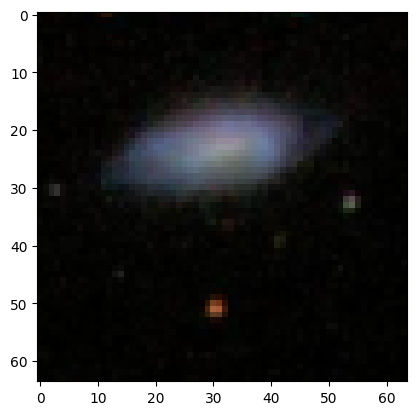

In [169]:
# trying to convert the .jpg images to .fits so that we can use it with astro libraries
img = iio.imread(DIR_64_WIDE + '605348.png')
plt.imshow(img)

In [131]:
def torch_batches(pics, labels, path=DATA, batch_size=30, rotate=False, fmt='jpg'):
    '''
    Generate batches of PyTorch tensors from a list of image filenames.
    DATA is a global variable with the path to the image folder.  
    '''
    angles = np.array([0,90,180,270])
    labels = torch.tensor(labels, dtype=torch.float32)
    l = len(pics)
    batches = int(l/batch_size)
    leftover = l % batch_size
    for batch in range(batches):
        start = batch * batch_size
        this_batch = pics[start:start+batch_size]
        batch_labels = labels[start:start+batch_size,:]
        
        if rotate:
            yield torch.tensor([scipy.ndimage.rotate(
                                plt.imread(path + pic, format=fmt),
                                reshape=False,
                                angle=np.random.randint(0,360)
                                )
                            for pic in this_batch], dtype=torch.float32).permute(0, 3, 1, 2), batch_labels, this_batch
        else:
            yield torch.tensor([ plt.imread(path + pic, format=fmt) for pic in this_batch], dtype=torch.float32).permute(0, 3, 1, 2), batch_labels, this_batch
    start = batches * batch_size
    this_batch = pics[start:start+leftover]
    batch_labels = labels[start:start+leftover,:]
    if rotate:
        yield torch.tensor([scipy.ndimage.rotate(
                            plt.imread(path + pic, format=fmt),
                            reshape=False,
                            angle=np.random.randint(0,360)
                            )
                        for pic in this_batch], dtype=torch.float32).permute(0, 3, 1, 2), batch_labels, this_batch
    
    yield torch.tensor([ plt.imread(path + pic, format=fmt) for pic in this_batch], dtype=torch.float32).permute(0, 3, 1, 2), batch_labels, this_batch

We can make a formula to calculat the output size:
using the formula `[(W-K+2P)/S]+1`
where: W is the input volume (424 in our case if we don't downsize)
K is the kernel size
P is the padding
S is the stride

In [13]:
def get_output_width(width, kernel, padding, stride):
    return int((width - kernel + 2*padding - 1) / stride + 1)

In [15]:
classes = labels.columns[1:]

in_width = 64


pool_kernel = 2
stride = 1 

c1_in = 3
c1_kernel = 9
c1_out = 64 
c1_conv_width = get_output_width(in_width, c1_kernel, c1_kernel/2, stride)
c1_pooled_width = get_output_width(c1_conv_width, pool_kernel/2, 0, pool_kernel)
print("C1: ", c1_conv_width)
print('P1: ', c1_pooled_width)

c2_kernel = 5
c2_out = 96
c2_conv_width = get_output_width(c1_pooled_width, c2_kernel, c2_kernel/2, stride)
c2_pooled_width = get_output_width(c2_conv_width, pool_kernel, pool_kernel/2, pool_kernel)
print("C2: ", c2_conv_width)
print('P2: ', c2_pooled_width)

c3_kernel = 3
c3_out = 128
c3_conv_width = get_output_width(c2_pooled_width, c3_kernel, c3_kernel/2, stride)
c3_pooled_width = get_output_width(c3_conv_width, pool_kernel, pool_kernel/2, pool_kernel)
print("C3: ", c3_conv_width)
print('P3: ', c3_pooled_width)

full_1_in = c3_out * c3_pooled_width * c3_pooled_width
full_1_out = 1024
full_2_out = 256
full_3_out = len(classes)


class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        '''
        These are the layers in the network, and their attributes are the
        weights and biases of the neurons. 
        '''
        self.conv1 = nn.Conv2d(in_channels=c1_in, 
                               out_channels=c1_out, 
                               kernel_size=c1_kernel,
                               stride=stride,
                               padding= int(c1_kernel/2),
                               padding_mode='zeros') 
        
        self.pool = nn.MaxPool2d(pool_kernel) # 2x2 kernel, stride of 2 so there's no overlap, and it's a max pooling strategy 
        self.conv2 = nn.Conv2d(in_channels=c1_out, 
                               out_channels=c2_out, 
                               kernel_size=c2_kernel,
                               stride=stride,
                               padding= int(c2_kernel/2),
                               padding_mode='zeros') 
        self.conv3 = nn.Conv2d(in_channels=c2_out, 
                               out_channels=c3_out, 
                               kernel_size=c3_kernel,
                               stride=stride,
                               padding= int(c3_kernel/2),
                               padding_mode='zeros') 
        self.conv2_bn = nn.BatchNorm2d(c2_out)
        self.conv3_bn = nn.BatchNorm2d(c3_out)
        # we can re-use the pooling step if the strategy stays the same 
        self.fc1 = nn.Linear(full_1_in, full_1_out)
        self.fc2 = nn.Linear(full_1_out, full_2_out)
        self.fc3 = nn.Linear(full_2_out, full_3_out)
        self.dropout = nn.Dropout(p=0.15) # randomly shut off 15% of neurons in the later  

    def forward(self, x):
        # feed each layer into the next 
        x = self.pool(F.relu(self.conv1(x))) # first convolution 
        x = self.pool(F.relu(self.conv2_bn(self.conv2(x)))) # second convolution 
        x = self.pool(F.relu(self.conv3_bn(self.conv3(x))))
        x = x.reshape(x.size(0),-1) # flatten output for fully connected layer 
        x = F.relu(self.dropout(self.fc1(x))) # Linear equation wrapped in activation function
        x = F.relu(self.dropout(self.fc2(x))) # 
        x = F.sigmoid(self.fc3(x)) # The output layer 
        return x 

net = Net()

C1:  64
P1:  32
C2:  32
P2:  16
C3:  16
P3:  8


In [18]:
loss_weight = torch.tensor(np.sum(y_train, axis = 0) / np.sum(y_train))



# figure out what this function does
def weighted_mse_loss(output, targets, weights):
    loss = (output - targets) ** 2
    loss = loss * weights.expand(loss.shape)
    loss = loss.mean(0)
    return loss.sum()
  
# optimizer = optim.SGD(net.parameters(), lr=0.0005, momentum=0.7)
optimizer = optim.Adam(net.parameters()) # Adam should converge faster than stochastic gradient descent

loss_history = []
batch_size = 1024 
mini_batch_size = 64 
display("Start")

for epoch in range(1,6): 
    batch_no = 1

    datagen = torch_batches(X_train, 
                        y_train, 
                        path=DIR_64_WIDE,
                        batch_size=batch_size,
                        rotate=True)
    
    for images, targets, _ in datagen: # big read from storage
        for mini_batch in range(int(batch_size/mini_batch_size)):
            start = mini_batch*mini_batch_size
            if start >= images.shape[0]:
                break
            finish = start + mini_batch_size
            optimizer.zero_grad()   
            outputs = net(images[start:finish])
            loss = weighted_mse_loss(outputs, targets[start:finish], loss_weight)
            loss.backward()
            optimizer.step()
        clear_output()
        display("Epoch %d, batch %d - loss: %.5f" % (epoch, batch_no, loss.item()))
        batch_no += 1
        loss_history.append((epoch, batch_no, loss.item()))

save(net, 'net_4.p')
torch.save(net, 'net_t_4.p')
save(optimizer, 'optim_4.p')
save(loss_history, 'hist_4.p')  

'Epoch 5, batch 50 - loss: 0.02091'

In [122]:
labels = load("labels.p")

In [124]:
labels

,GalaxyID,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,100008.jpg,0.383147,0.616853,0.000000,0.000000,0.616853,0.038452,0.578401,0.418398,0.198455,...,0.000000,0.279952,0.138445,0.000000,0.000000,0.092886,0.000000,0.000000,0.0,0.325512
1,100023.jpg,0.327001,0.663777,0.009222,0.031178,0.632599,0.467370,0.165229,0.591328,0.041271,...,0.018764,0.000000,0.131378,0.459950,0.000000,0.591328,0.000000,0.000000,0.0,0.000000
2,100053.jpg,0.765717,0.177352,0.056931,0.000000,0.177352,0.000000,0.177352,0.000000,0.177352,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
3,100078.jpg,0.693377,0.238564,0.068059,0.000000,0.238564,0.109493,0.129071,0.189098,0.049466,...,0.000000,0.094549,0.000000,0.094549,0.189098,0.000000,0.000000,0.000000,0.0,0.000000
4,100090.jpg,0.933839,0.000000,0.066161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61573,999948.jpg,0.510379,0.489621,0.000000,0.059207,0.430414,0.000000,0.430414,0.226257,0.204157,...,0.000000,0.226257,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.226257
61574,999950.jpg,0.901216,0.098784,0.000000,0.000000,0.098784,0.000000,0.098784,0.000000,0.098784,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
61575,999958.jpg,0.202841,0.777376,0.019783,0.116962,0.660414,0.067245,0.593168,0.140022,0.520391,...,0.000000,0.000000,0.090673,0.049349,0.000000,0.067726,0.000000,0.000000,0.0,0.072296
61576,999964.jpg,0.091000,0.909000,0.000000,0.045450,0.863550,0.022452,0.841098,0.795330,0.068220,...,0.000000,0.068398,0.318132,0.408799,0.227464,0.408799,0.090668,0.023065,0.0,0.045334


In [132]:
net = load('net_4.p')
datagen = torch_batches(X_test,
                        y_test,
                        path = DIR_64_WIDE,
                        batch_size = 1000)

pred = np.empty((0, len(classes)), float)

for images, targets, pics in datagen:
    outputs = net(images)
    pred = np.append(pred, outputs.detach().numpy(), axis = 0)

RMSE(y_test,pred)

0.11323909753948957

In [170]:
pred.shape

(12316, 37)

In [148]:
pred_first = np.argmax(pred[:, :3], axis=1)
test_first = np.argmax(y_test[:, :3], axis = 1)

In [137]:
pred_first

array([1, 1, 1, ..., 0, 1, 1], dtype=int64)

In [138]:
y_test

array([[0.018765  , 0.95509   , 0.026146  , ..., 0.        , 0.        ,
        0.10738139],
       [0.806705  , 0.14038   , 0.052915  , ..., 0.        , 0.        ,
        0.        ],
       [0.662354  , 0.337646  , 0.        , ..., 0.        , 0.        ,
        0.04410138],
       ...,
       [0.540807  , 0.439755  , 0.019437  , ..., 0.        , 0.        ,
        0.        ],
       [0.367352  , 0.615882  , 0.016766  , ..., 0.        , 0.        ,
        0.2119674 ],
       [0.147845  , 0.838105  , 0.01405   , ..., 0.        , 0.        ,
        0.        ]])

In [139]:
X_test

30888    553402.png
23964    449744.png
53475    879640.png
16284    340485.png
60574    985545.png
            ...    
20546    400502.png
57672    942291.png
51949    856993.png
22630    430873.png
31104    556569.png
Name: GalaxyID, Length: 12316, dtype: object

In [23]:
y_test.shape

(12316, 37)

In [145]:
pred_first = np.argmax(pred[:, :3], axis = 1)
test_first = np.argmax(y_test_small.iloc[:, :3].values, axis = 1)


ValueError: operands could not be broadcast together with shapes (12316,) (500,) 

In [149]:
pred_first.shape

(12316,)

In [150]:
test_first.shape

(12316,)

In [151]:
result = np.where(pred_first == test_first, 0, 1)

# Check the result
print(result)

[0 1 1 ... 0 0 0]


In [152]:
# Assuming X_test is a pandas Series
X_test_jpg = X_test.str.replace('.png', '.jpg', regex=False)

# Display the new Series
print(X_test_jpg)


30888    553402.jpg
23964    449744.jpg
53475    879640.jpg
16284    340485.jpg
60574    985545.jpg
            ...    
20546    400502.jpg
57672    942291.jpg
51949    856993.jpg
22630    430873.jpg
31104    556569.jpg
Name: GalaxyID, Length: 12316, dtype: object


In [153]:
filtered_X_test_jpg = X_test_jpg[result == 1]

# Display the filtered Series
print(filtered_X_test_jpg)

23964    449744.jpg
53475    879640.jpg
19482    385899.jpg
1608     123933.jpg
22779    432847.jpg
            ...    
18911    377821.jpg
34366    602911.jpg
1850     127730.jpg
4914     173235.jpg
40521    690338.jpg
Name: GalaxyID, Length: 1971, dtype: object


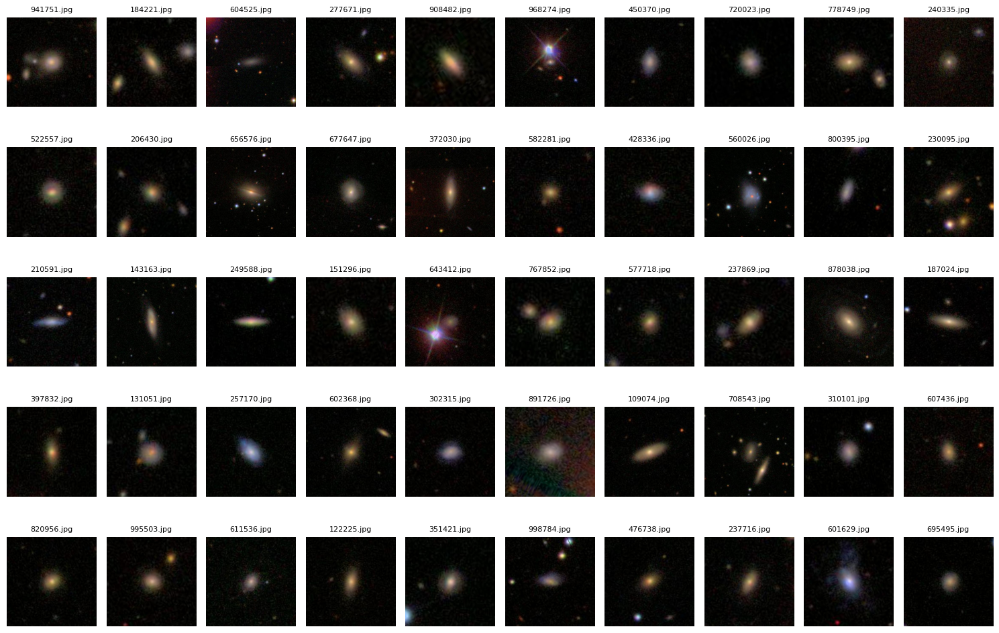

In [158]:
selected_images = filtered_X_test_jpg.sample(n=50, random_state=42)

# Base path to the images
base_path = "D:/images_training_rev1/images_training_rev1/"

# Display the selected images
plt.figure(figsize=(15, 10))  # Set figure size
for i, image_name in enumerate(selected_images):
    image_path = base_path + image_name  # Construct full path
    img = Image.open(image_path)  # Open image
    
    # Add subplot for each image
    plt.subplot(5, 10, i + 1)  # 5 rows, 6 columns
    plt.imshow(img)
    plt.axis('off')  # Turn off axis
    plt.title(image_name, fontsize=8)  # Optional: display the image name

plt.tight_layout()
plt.show()

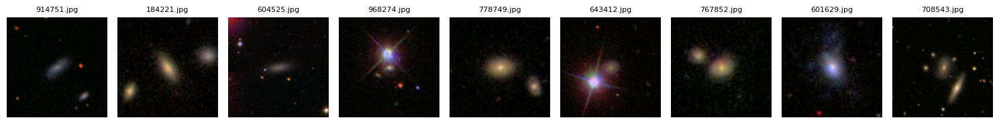

In [161]:
# List of specific image IDs to display
specific_images = [
    "914751.jpg", "184221.jpg", "604525.jpg", "968274.jpg",
    "778749.jpg", "643412.jpg", "767852.jpg", "601629.jpg", "708543.jpg"
]

# Base path to the images
base_path = "D:/images_training_rev1/images_training_rev1/"

# Display the specified images
plt.figure(figsize=(15, 10))  # Set figure size
for i, image_name in enumerate(specific_images):
    image_path = base_path + image_name  # Construct full path
    try:
        img = Image.open(image_path)  # Open image
        
        # Add subplot for each image
        plt.subplot(1, 9, i + 1)  # 3 rows, 3 columns
        plt.imshow(img)
        plt.axis('off')  # Turn off axis
        plt.title(image_name, fontsize=8)  # Optional: display the image name
    except FileNotFoundError:
        print(f"Image not found: {image_path}")

plt.tight_layout()
plt.savefig("misclassified.jpg")
plt.show()


In [101]:
y_test_small

,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,Class5.1,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
17060,0.024520,0.963071,0.012409,0.026969,0.936102,0.330308,0.605794,0.907544,0.028559,0.000000,...,0.000000,0.102257,0.649527,0.155759,0.000000,0.593751,0.260038,0.000000,0.000000,0.053755
51703,0.194530,0.798894,0.006577,0.163689,0.635205,0.545913,0.089292,0.000000,0.635205,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
12097,0.127237,0.872544,0.000219,0.045788,0.826756,0.159768,0.666987,0.536206,0.290549,0.000000,...,0.000000,0.214451,0.235774,0.085981,0.059881,0.085305,0.000000,0.254661,0.000000,0.136359
29947,0.061000,0.909000,0.030000,0.120897,0.788103,0.423999,0.364104,0.758155,0.029948,0.060684,...,0.090673,0.636850,0.121305,0.000000,0.060652,0.121305,0.000000,0.000000,0.030326,0.545872
50763,0.446486,0.496328,0.057186,0.000000,0.496328,0.000000,0.496328,0.000000,0.496328,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34346,0.431338,0.568662,0.000000,0.055021,0.513641,0.000000,0.513641,0.047819,0.465822,0.065692,...,0.055021,0.030147,0.000000,0.017672,0.000000,0.000000,0.000000,0.000000,0.000000,0.047819
25701,0.288806,0.685780,0.025414,0.249164,0.436616,0.000000,0.436616,0.116114,0.320502,0.000000,...,0.000000,0.116114,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.116114
18791,0.353014,0.619664,0.027322,0.000000,0.619664,0.000000,0.619664,0.000000,0.619664,0.413316,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
21736,0.033586,0.966122,0.000292,0.000000,0.966122,0.809212,0.156910,0.353762,0.612360,0.000000,...,0.000000,0.149786,0.166146,0.037830,0.000000,0.230984,0.122778,0.000000,0.000000,0.000000


In [142]:
accuracy_rate = np.mean(pred_first == test_first) * 100

print(f"Accuracy rate: {accuracy_rate:.4f}%")

Accuracy rate: 83.9964%


In [176]:
# reinitialize it to use 
datagen = torch_batches(X_test,
                        y_test,
                        path = DIR_64_WIDE,
                        batch_size = 1)

In [177]:
image_batch = next(datagen)
image = image_batch[0]

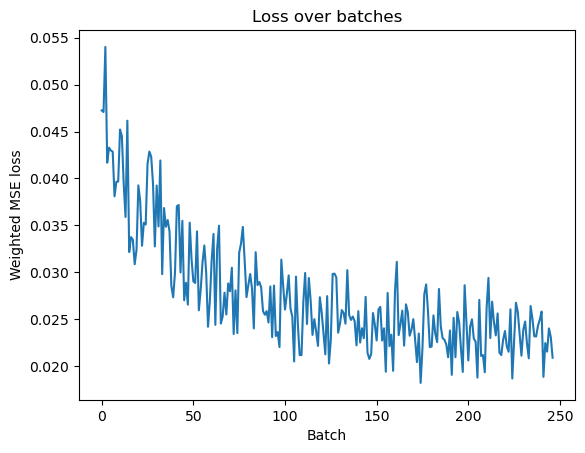

In [21]:
import matplotlib.pyplot as plt
title = "Loss over batches"
plt.title(title)
plt.xlabel('Batch')
plt.ylabel('Weighted MSE loss')
plt.plot([error[2] for error in loss_history[3:]])
plt.show()

In [171]:
'''
We should work on getting the dimensions down. The Zoobot paper mentioned using IPCA from D = 1280 to D = 15. Let's see if we can do something similar here
'''
net = torch.load('net_t_4.p')
net.eval()

Net(
  (conv1): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(64, 96, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (conv3): Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_bn): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3_bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=8192, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (fc3): Linear(in_features=256, out_features=37, bias=True)
  (dropout): Dropout(p=0.15, inplace=False)
)

In [172]:
# set up hooks for each layer

activations = {}

def get_activation(name):
    def hook(model, input, output):
        activations[name] = output.detach()
    return hook

In [173]:
# Register hooks for each layer
net.conv1.register_forward_hook(get_activation('conv1'))
net.pool.register_forward_hook(get_activation('pool1'))
net.conv2.register_forward_hook(get_activation('conv2'))
net.pool.register_forward_hook(get_activation('pool2'))
net.conv3.register_forward_hook(get_activation('conv3'))
net.pool.register_forward_hook(get_activation('pool3'))

In [178]:
# run our test image through the network
output = net(image)

C:\Users\William\AppData\Local\Temp\ipykernel_49492\3732638036.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '553402.jpg')


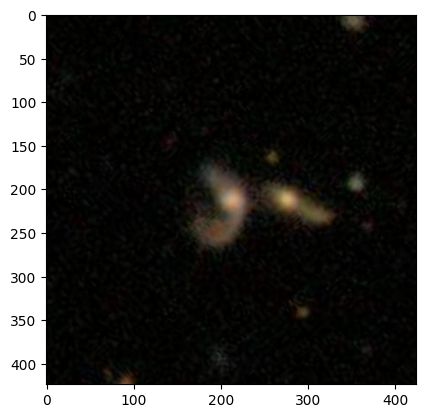

In [166]:
img = iio.imread(DATA + '553402.jpg')
plt.imshow(img)

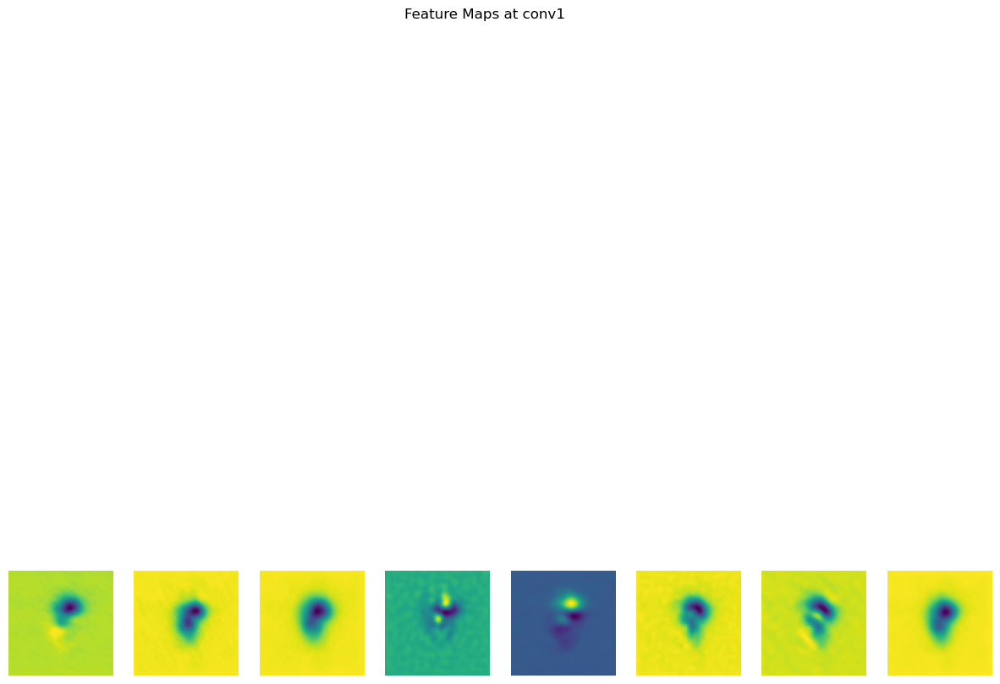

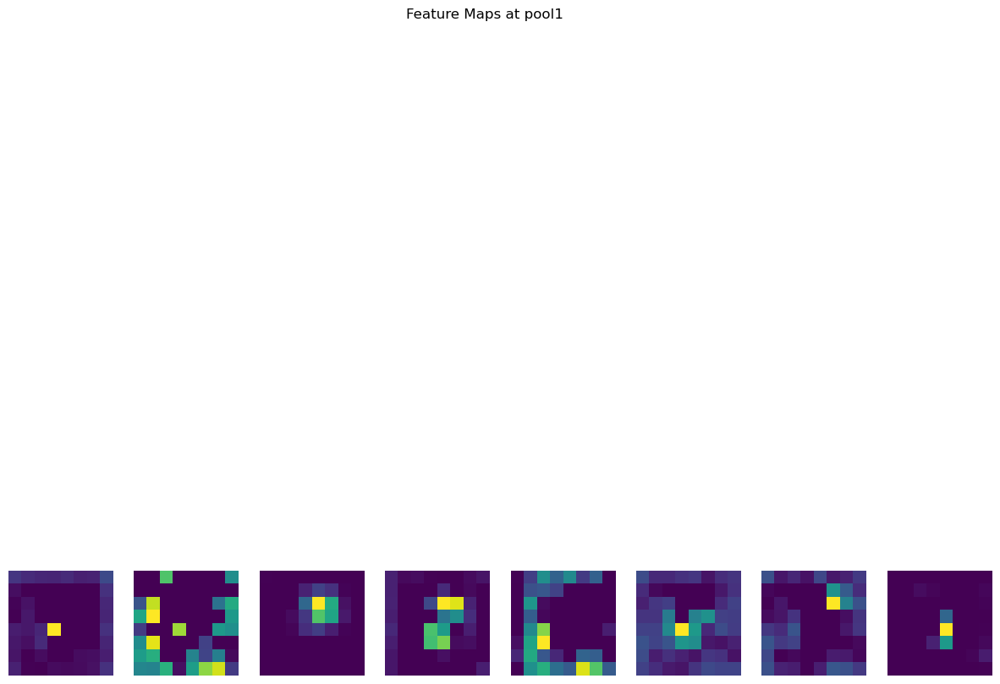

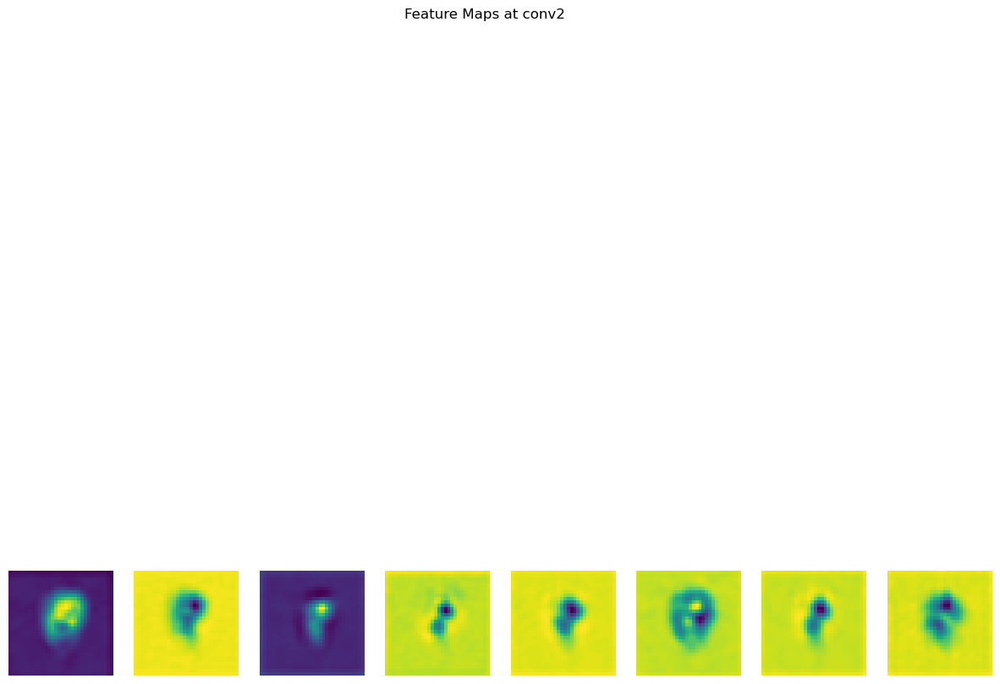

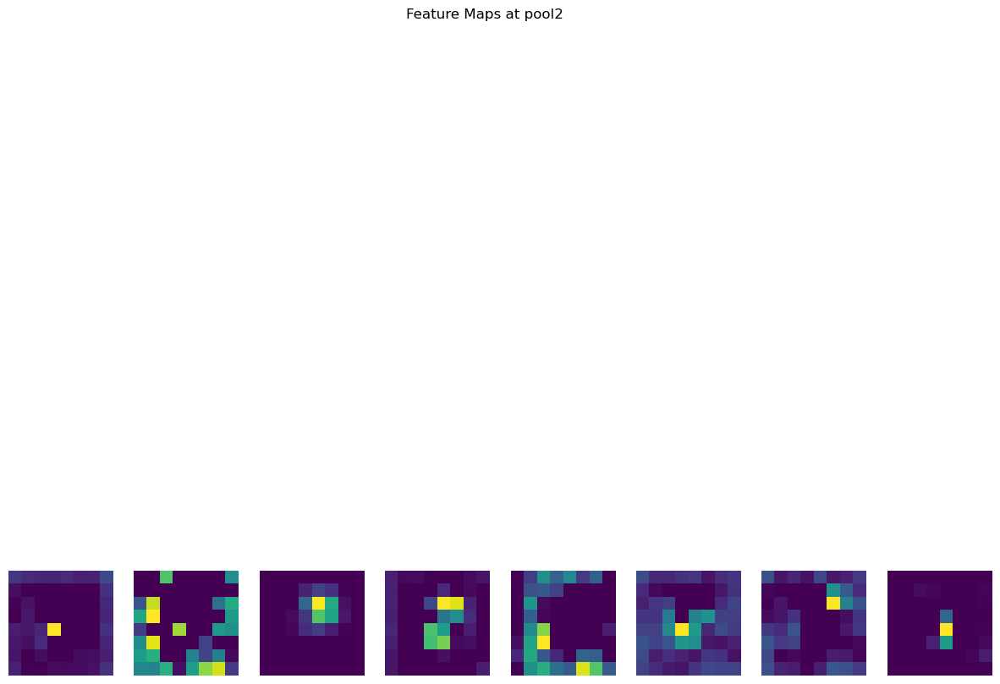

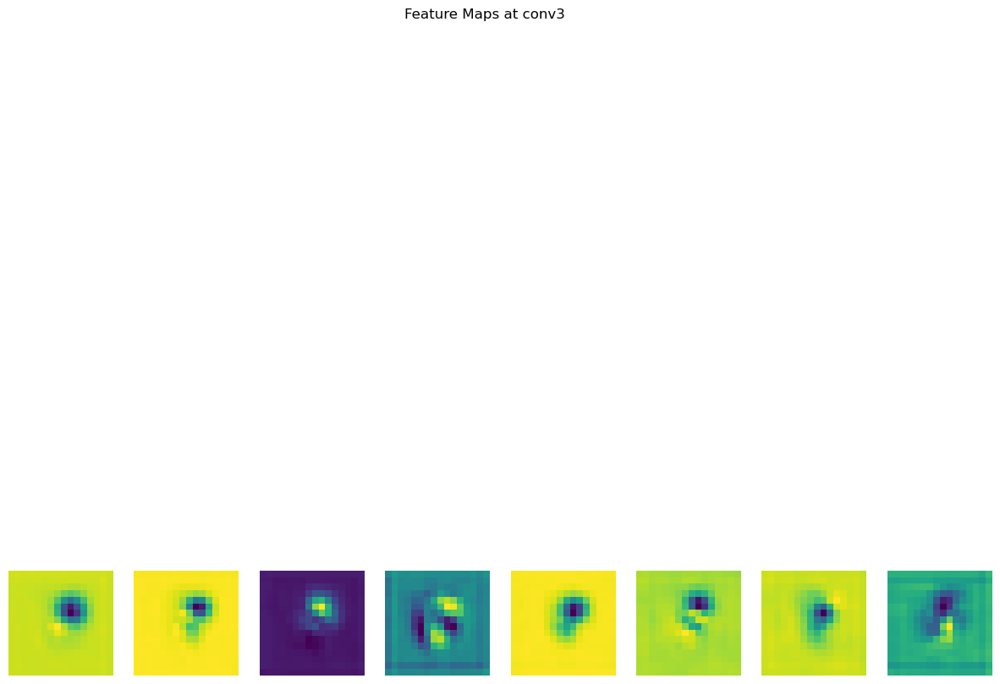

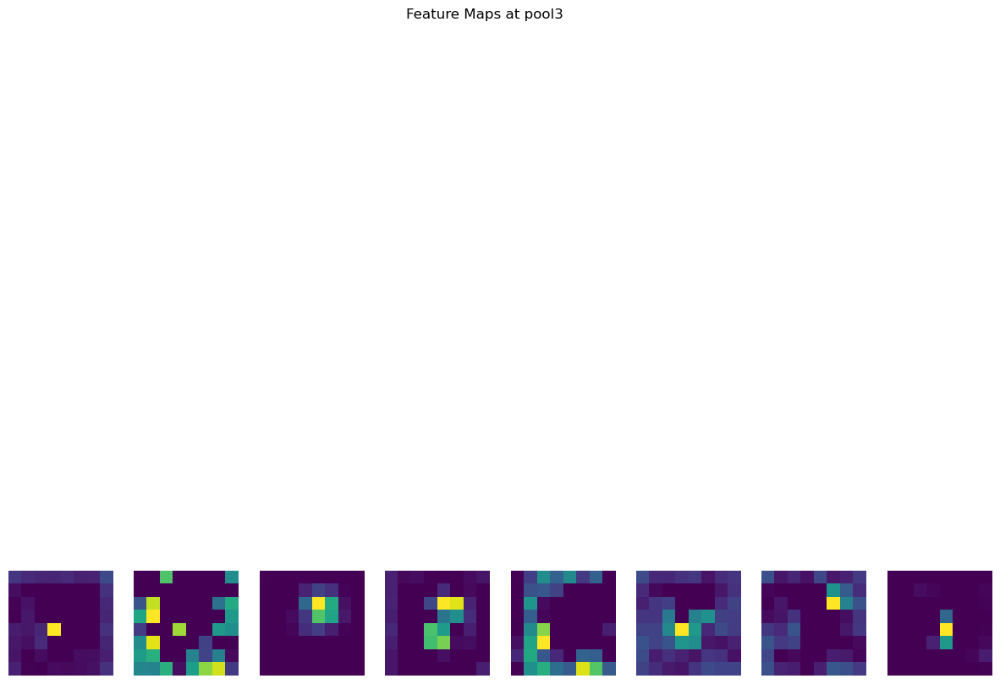

In [47]:
def visualize_feature_maps(activations, layer_name, num_channels=8):
    # Get the feature map for the specified layer
    feature_map = activations[layer_name][0]  # Extract the feature map for the first image in the batch
    
    # Set up the plot
    plt.figure(figsize=(15, 15))
    plt.suptitle(f"Feature Maps at {layer_name}")
    
    # Display the specified number of channels
    for i in range(num_channels):
        plt.subplot(1, num_channels, i + 1)
        plt.imshow(feature_map[i].cpu(), cmap='viridis')  # Use 'viridis' for better contrast
        plt.axis('off')
    plt.show()

# Visualize the outputs for each layer
visualize_feature_maps(activations, 'conv1')
visualize_feature_maps(activations, 'pool1')
visualize_feature_maps(activations, 'conv2')
visualize_feature_maps(activations, 'pool2')
visualize_feature_maps(activations, 'conv3')
visualize_feature_maps(activations, 'pool3')    

In [179]:
features = []

def hook_fn(module, input, output):
    features.append(output.reshape(output.size(0), -1))

handle = net.pool.register_forward_hook(hook_fn)

_ = net(image)

print("Feature vector:", features[0])

handle.remove()

Feature vector: tensor([[0.0902, 0.0780, 0.0777,  ..., 0.0000, 0.0098, 0.0175]],
       grad_fn=<UnsafeViewBackward0>)


In [180]:
features[0].shape

torch.Size([1, 65536])

In [181]:
activation = {}

def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach().reshape(output.size(0), -1)
    return hook


In [182]:
hook_handle = net.pool.register_forward_hook(get_activation('learned_representation'))

In [183]:
datagen_test = torch_batches(X_test,
                        y_test,
                        path = DIR_64_WIDE,
                        batch_size = 1000)



In [184]:
datagen = torch_batches(X_train,
                        y_train,
                        path = DIR_64_WIDE,
                        batch_size = 1000)

In [185]:
test_representations = []

net.eval()

for images, targets, _ in datagen:
    with torch.no_grad():
        output = net(images)
        learned_rep = activation['learned_representation']
        test_representations.append(learned_rep.cpu().numpy())

test_representations = np.concatenate(test_representations, axis = 0)

In [186]:
test_representations_test = []

net.eval()

for images, targets, _ in datagen_test:
    with torch.no_grad():
        output = net(images)
        learned_rep = activation['learned_representation']
        test_representations_test.append(learned_rep.cpu().numpy())
test_representations_test = np.concatenate(test_representations_test, axis = 0)

In [187]:
test_representations.shape # bug here...

(49262, 8192)

In [188]:
test_representations_test.shape

(12316, 8192)

In [189]:
hook_handle.remove()

In [190]:
X_train.shape

(49262,)

In [191]:
test_representations

array([[0.1586318 , 0.03399468, 0.09766527, ..., 0.        , 0.        ,
        0.        ],
       [0.07176243, 0.2792498 , 0.14712979, ..., 0.        , 0.        ,
        0.        ],
       [0.10655664, 0.08298755, 0.11846183, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.10337852, 0.07617196, 0.1123717 , ..., 0.        , 0.        ,
        0.        ],
       [0.11070393, 0.15905534, 0.1430712 , ..., 0.        , 0.        ,
        0.        ],
       [0.15694223, 0.11202831, 0.09917405, ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

In [192]:
# using IPCA 
from sklearn.decomposition import IncrementalPCA
import numpy as np

In [193]:
n_components = 15
chunk_size = 1024
ipca = IncrementalPCA(n_components=n_components)

In [194]:
for i in range(0, test_representations.shape[0], chunk_size):
    ipca.partial_fit(test_representations[i:i+chunk_size])

In [195]:
test_representations_15d = []

for i in range(0, test_representations.shape[0], chunk_size):
    chunk_transformed = ipca.transform(test_representations[i:i+chunk_size])
    test_representations_15d.append(chunk_transformed)

test_representations_15d = np.concatenate(test_representations_15d, axis = 0)

In [196]:
test_representations_15d.shape

(49262, 15)

In [197]:
test_representations_15d

array([[ 28.45845534,  18.15534417,  11.95202673, ...,  -9.89978022,
          7.48134253,  -2.87762651],
       [-23.3291601 ,  16.26080069,  -0.47253523, ...,   6.95715623,
          4.28517141,   3.99155293],
       [ 27.27632984, -11.44215   ,   2.18060371, ...,   1.8872593 ,
          0.05931681,  -1.48317594],
       ...,
       [ 14.5778218 ,   9.71500139, -16.60583786, ...,  -2.46243537,
          2.02988261,  -0.14830995],
       [ -2.90124244,   8.97134189,  20.85383752, ...,  -1.76953039,
         -4.42944127,   0.59228251],
       [ -6.28405982,   4.38706423,  -1.73282953, ...,  -3.84418278,
         -0.96653566,   1.65302178]])

In [93]:
np.save("test_representations_15d.npy", test_representations_15d)

In [94]:
np.save("test_representations.npy", test_representations)

In [199]:
import umap

C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [200]:
test_representations_15d = np.load("test_representations_15d.npy")

umap_reducer = umap.UMAP(n_components = 2)

test_representations_2d = umap_reducer.fit(test_representations_15d)

In [201]:
import matplotlib.pyplot as plt

# Plot the 2D UMAP projection
plt.figure(figsize=(10, 8))
plt.scatter(test_representations_2d[:, 0], test_representations_2d[:, 1], s=1, alpha=0.7)
plt.title("2D UMAP Projection of Representations")
plt.xlabel("UMAP Dimension 1")
plt.ylabel("UMAP Dimension 2")
plt.show()


TypeError: 'UMAP' object is not subscriptable

<Figure size 1000x800 with 0 Axes>

C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\dask\dataframe\__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\numba\np\ufunc\dufunc.py:343: NumbaWarning: Compilation requested for previously compiled argument types ((uint32,)). This has no effect and perhaps indicates a bug in the calling code (compiling a ufunc more than once for the same signature
  warnings.warn(msg, errors.NumbaWarning)
C:\Users\William\anaconda3\envs\zoobot\lib\site-packages\numba\np\ufunc\dufunc.py:343: NumbaWarning: Compilation requested for previously compiled argument types ((uint32,)). This has no effect and perhaps indicates a bug in the calling code (compiling a ufunc more than once for the same signature
  warnings.warn(msg, err

<Axes: >

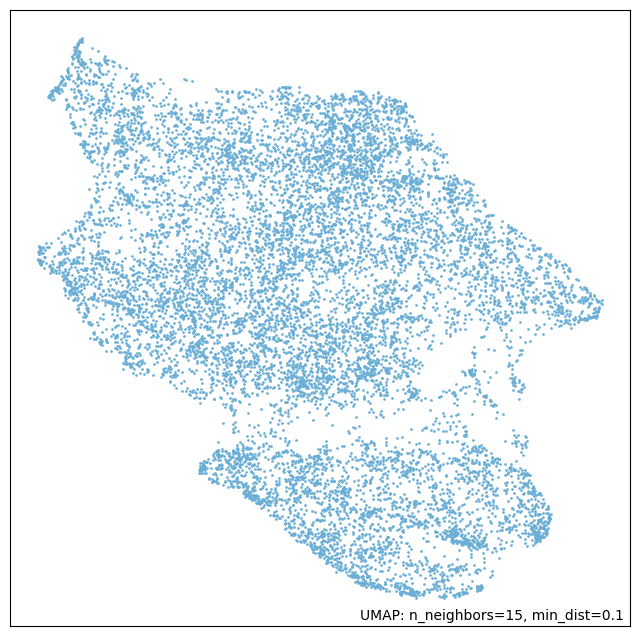

In [202]:
import umap.plot

umap.plot.points(test_representations_2d)

In [112]:
datagen = torch_batches(X_test,
                        y_test,
                        path = DIR_64_WIDE,
                        batch_size = 1000)

In [113]:
net.eval()  # Set the model to evaluation mode

predictions = []

for images, targets, _ in datagen:
    with torch.no_grad():
        outputs = net(images)  # Get model predictions
        predictions.append(outputs.cpu().numpy())  # Move to CPU and convert to NumPy

# Concatenate predictions to get an array of shape (num_samples, num_classes)
predictions = np.concatenate(predictions, axis=0)


In [115]:
predicted_labels = np.argmax(predictions, axis = 1)

In [114]:
predictions.shape

(12316, 37)

In [111]:
X_test.shape

(12316,)

In [118]:
y_test


array([[0.018765  , 0.95509   , 0.026146  , ..., 0.        , 0.        ,
        0.10738139],
       [0.806705  , 0.14038   , 0.052915  , ..., 0.        , 0.        ,
        0.        ],
       [0.662354  , 0.337646  , 0.        , ..., 0.        , 0.        ,
        0.04410138],
       ...,
       [0.540807  , 0.439755  , 0.019437  , ..., 0.        , 0.        ,
        0.        ],
       [0.367352  , 0.615882  , 0.016766  , ..., 0.        , 0.        ,
        0.2119674 ],
       [0.147845  , 0.838105  , 0.01405   , ..., 0.        , 0.        ,
        0.        ]])

In [121]:
np.argmax(y_test, axis = 1)

array([ 1, 14, 14, ..., 14, 14,  1], dtype=int64)

<Axes: >

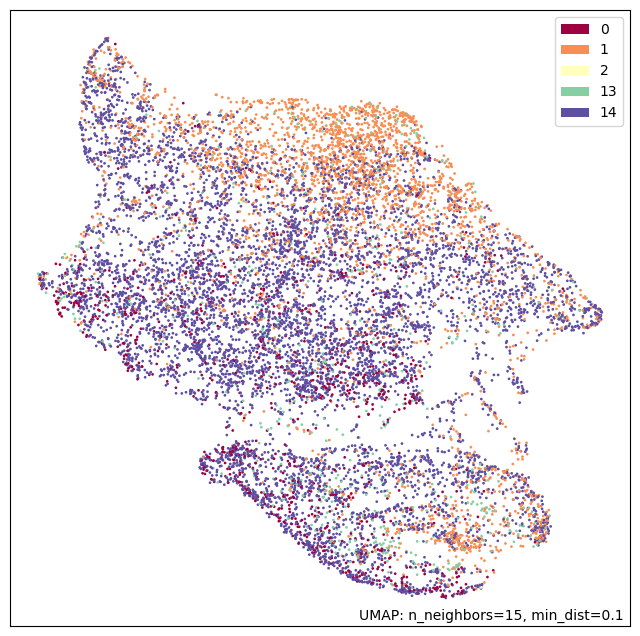

In [125]:
umap.plot.points(test_representations_2d, labels = np.argmax(y_test, axis = 1))

0 : smooth
1 : featured or disc
2 : star or artifact
13 : oddities
14 : no oddities

In [129]:
# try to plot images
from PIL import Image
num_samples = 30
indices = np.random.choice(test_representations_2d.shape[0], num_samples, replace = False)

AttributeError: 'UMAP' object has no attribute 'shape'

In [130]:
test_representations_2d

UMAP(tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})

In [132]:
np.save("predictions.npy", predictions)

In [209]:
custom_labels = []

predictions = np.load("predictions.npy")

for pred in predictions:
    if pred[0] > 0.5:
        custom_labels.append('smooth')
    elif pred[3] > 0.5:
        custom_labels.append('edge on')
    elif pred[7] > 0.5:
        custom_labels.append('spirals')
    else:
        custom_labels.append('neither')

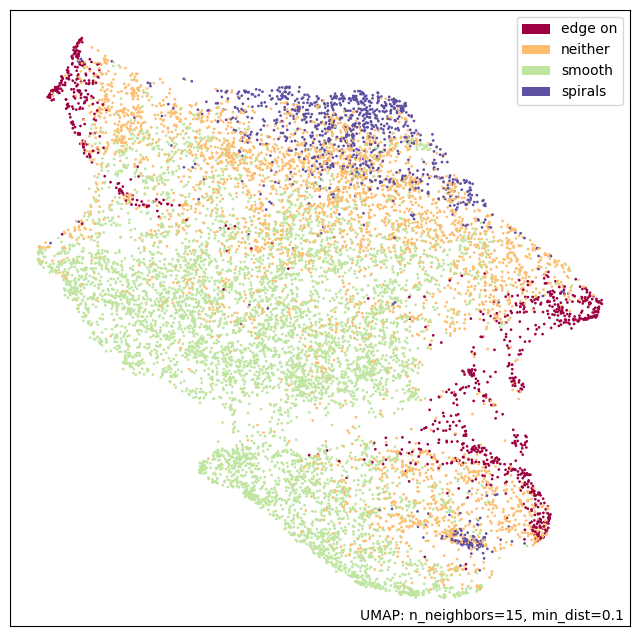

In [210]:
umap.plot.points(umap_reducer, labels = np.array(custom_labels))
plt.savefig("umap_2.jpg")

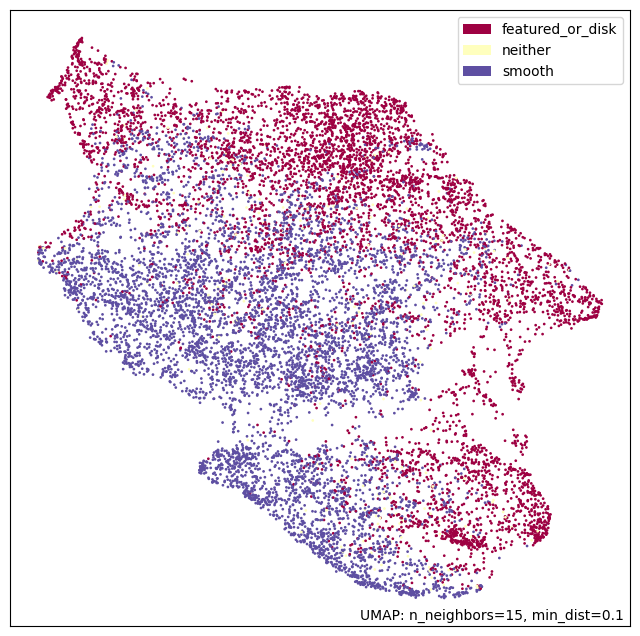

In [208]:
umap.plot.points(umap_reducer, labels = np.array(custom_labels))
plt.savefig("umap_1.jpg")

In [205]:
custom_labels = []

predictions = np.load("predictions.npy")

for pred in predictions:
    if pred[0] > 0.5:
        custom_labels.append('smooth')
    elif pred[1] > 0.5:
        custom_labels.append('featured_or_disk')
    else:
        custom_labels.append('neither')

<Axes: >

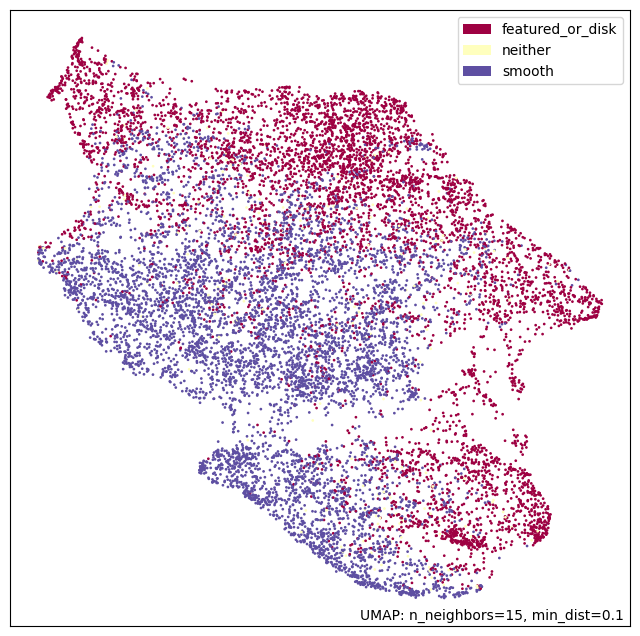

In [206]:
umap.plot.points(umap_reducer, labels = np.array(custom_labels))

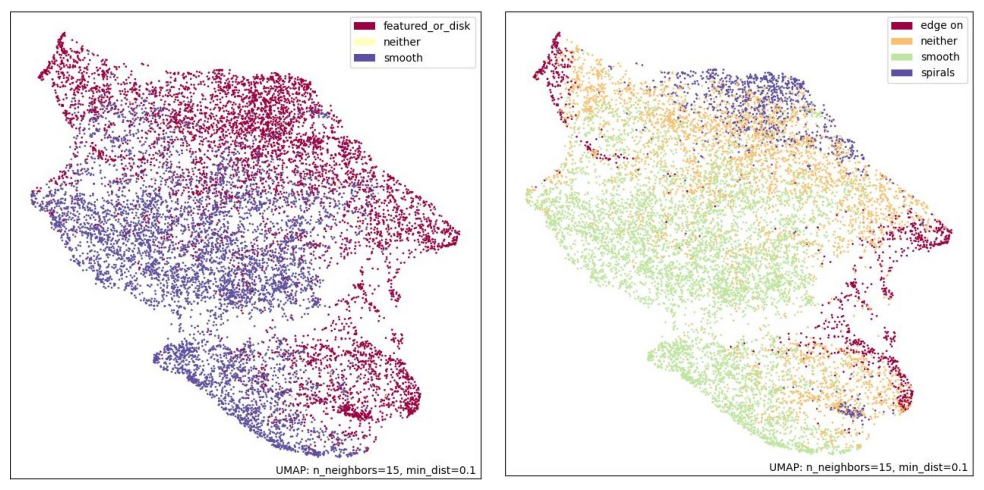

In [212]:
image1 = Image.open("umap_1.jpg")
image2 = Image.open("umap_2.jpg")

# Create a side-by-side plot
plt.figure(figsize=(10, 5))  # Adjust the figure size as needed

# Plot the first image
plt.subplot(1, 2, 1)  # 1 row, 2 columns, first plot
plt.imshow(image1)
plt.axis('off')  # Turn off axes

# Plot the second image
plt.subplot(1, 2, 2)  # 1 row, 2 columns, second plot
plt.imshow(image2)
plt.axis('off')  # Turn off axes

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig("umap.jpg")
plt.show()

smooth are smooth, contains either rings (in oddities) or no odds


Is the galaxy simply smooth and rounded, with no sign of a disk?
1.1 Smooth? -> GOTO #7
1.2 Featured or disc? -> GOTO #2
1.3 Star or artifact? -> END
Could this be a disk viewed edge-on?
2.1 Yes -> GOTO #9
2.2 No -> GOTO #3
Is there a sign of a bar feature through the centre of the galaxy?
3.1 Yes -> #4
3.2 No -> #4
Is there any sign of a spiral pattern?
4.1 Yes -> #6
4.2 No -> #6
How prominent is the central bulge, compared with the rest of the galaxy?
5.1 No bulge -> #6
5.2 Just noticeable -> GOTO #6
5.3 Obvious -> #6
5.4 Dominant -> #6
Is there anything odd?
6.1 Yes -> #8
6.2 No -> END
How rounded is it?
7.1 Completely round -> #6
7.2 In between -> #6
7.3 Cigar shaped -> #6
Is the odd feature a ring, or is the galaxy distrubed or irregular?
8.1 Ring -> END
8.2 Lens or arc -> END
8.3 Disturbed -> END
8.4 Irregular -> END
8.5 Other -> END
8.6 Merger -> END
8.7 Dust lane -> END
Does the galaxy have a bulge at its centre? If so, what shape?
9.1 Rounded -> #6
9.2 Boxy -> #6
9.3 No bulge -> #6
How tightly wound do the spiral arms appear?
10.1 Tight -> #11
10.2 Medium -> #11
10.3 Loose -> #11
How many spiral arms are there?
11.1 1 -> #5
11.2 2 -> #5
11.3 3 -> #5
11.4 4 -> #5
11.5 More than four -> #5
11.6 Can't tell -> #5

In [232]:
# filter the points labeled as 'spirals'
spirals_index = [i for i, label in enumerate(custom_labels) if label == 'spirals']
len(spirals_index)

1073

In [258]:
# we can get an array of the embeddings by doing:
umap_reducer.embedding_

array([[-0.63942003,  7.34081   ],
       [ 2.6982293 ,  1.0106848 ],
       [-2.3336859 ,  6.3201466 ],
       ...,
       [ 3.1569805 ,  2.162011  ],
       [ 3.8155267 ,  2.1379805 ],
       [ 2.9842277 , -1.1641159 ]], dtype=float32)

In [274]:
# take a random spiral
random_spiral = random.choice(spirals_index)
random_spiral

5079

In [240]:
# so its the 2655 image in the y_test data. Let's load it from X_test
X_test

30888    553402.png
23964    449744.png
53475    879640.png
16284    340485.png
60574    985545.png
            ...    
20546    400502.png
57672    942291.png
51949    856993.png
22630    430873.png
31104    556569.png
Name: GalaxyID, Length: 12316, dtype: object

In [241]:
X_test.iloc[4109]

'338715.png'

C:\Users\William\AppData\Local\Temp\ipykernel_49492\1778936338.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + "338715.jpg")


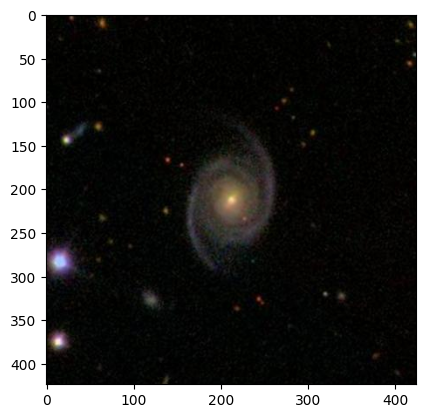

In [242]:
img = iio.imread(DATA + "338715.jpg")
plt.imshow(img)

In [243]:
# spiral classification
predictions[4109][7]

0.81990653

In [244]:
spiral_point = umap_reducer.embedding_[random_spiral]
spiral_point

array([1.3047655, 7.050983 ], dtype=float32)

In [248]:
# calculate distances ( is there a umap method for this? )
distances = np.linalg.norm(umap_reducer.embedding_ - spiral_point, axis = 1)
distances.shape

(12316,)

In [249]:
nearest_neighbor_index = np.argmin(distances[distances > 0])
farthest_neighbor_index = np.argmax(distances)
nearest_neighbor_index, farthest_neighbor_index

(1895, 10610)

In [250]:
nearest_label = custom_labels[nearest_neighbor_index]
nearest_coords = umap_reducer.embedding_[nearest_neighbor_index]
farthest_label = custom_labels[farthest_neighbor_index]
farthest_coords = umap_reducer.embedding_[farthest_neighbor_index]

In [251]:
nearest_label

'spirals'

In [252]:
nearest_coords

array([1.2826583, 7.017272 ], dtype=float32)

In [253]:
farthest_coords

array([ 4.4688706, -4.4264083], dtype=float32)

In [254]:
farthest_label

'smooth'

In [255]:
X_test.iloc[1895]

'949393.png'

C:\Users\William\AppData\Local\Temp\ipykernel_49492\2133960143.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '949393.jpg')


Text(0.5, 1.0, 'Nearest neighbour')

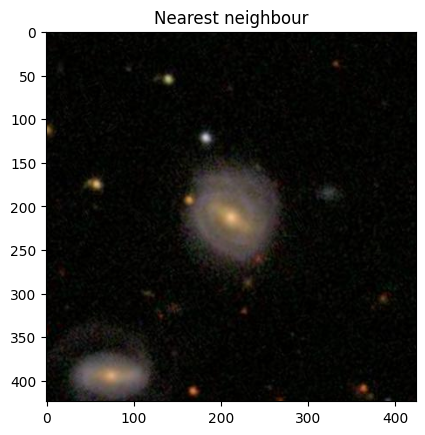

In [256]:
img = iio.imread(DATA + '949393.jpg')
plt.imshow(img)
plt.title("Nearest neighbour")

In [71]:
X_test.iloc[10610]

'676751.png'

In [295]:
def display_selected_galaxies_with_neighbors(umap_embedding, X_test, data_path, indices):
    """
    Select specific galaxies from the UMAP embedding by indices, find their 6 closest neighbors,
    and display their images side by side, saving one big layout as an image.

    Parameters:
    umap_embedding (np.ndarray): 12000 x 2 array of UMAP coordinates.
    X_test (pd.Series): Series containing image names (.png format).
    data_path (str): Base file path to the images.
    indices (list of int): List of indices of the galaxies to display.

    """
    # Create a large figure to display all selected galaxies and their neighbors
    num_rows = len(indices)
    num_cols = 7  # Each galaxy + 6 neighbors
    plt.figure(figsize=(20, 5 * num_rows))  # Adjust figure size based on the number of rows

    for row_num, index in enumerate(indices):  # Loop over provided indices
        # Select the galaxy by index
        selected_galaxy = umap_embedding[index]

        # Calculate distances to all other galaxies
        distances = euclidean_distances([selected_galaxy], umap_embedding)[0]

        # Get indices of the 6 closest neighbors (including itself as the closest)
        closest_indices = np.argsort(distances)[:7]  # 1 selected + 6 neighbors

        # Get the image names for the selected galaxy and its neighbors
        image_names = X_test.iloc[closest_indices].str.replace('.png', '.jpg', regex=False).tolist()

        for col_num, image_name in enumerate(image_names):
            image_path = f"{data_path}/{image_name}"
            try:
                img = Image.open(image_path)
                plt.subplot(num_rows, num_cols, row_num * num_cols + col_num + 1)
                plt.imshow(img)
                plt.axis('off')  # Turn off axes
                if col_num == 0:
                    plt.title(f"Smooth Galaxy {row_num + 1}", fontsize=10)
                else:
                    plt.title(f"Neighbor {col_num}", fontsize=10)
            except FileNotFoundError:
                print(f"Image not found: {image_path}")
    plt.subplots_adjust(wspace = 0, hspace = 0)

    plt.tight_layout()
    # Save the entire figure as one big image
    plt.savefig("smooths_1.jpg", dpi=300, bbox_inches='tight')
    plt.show()

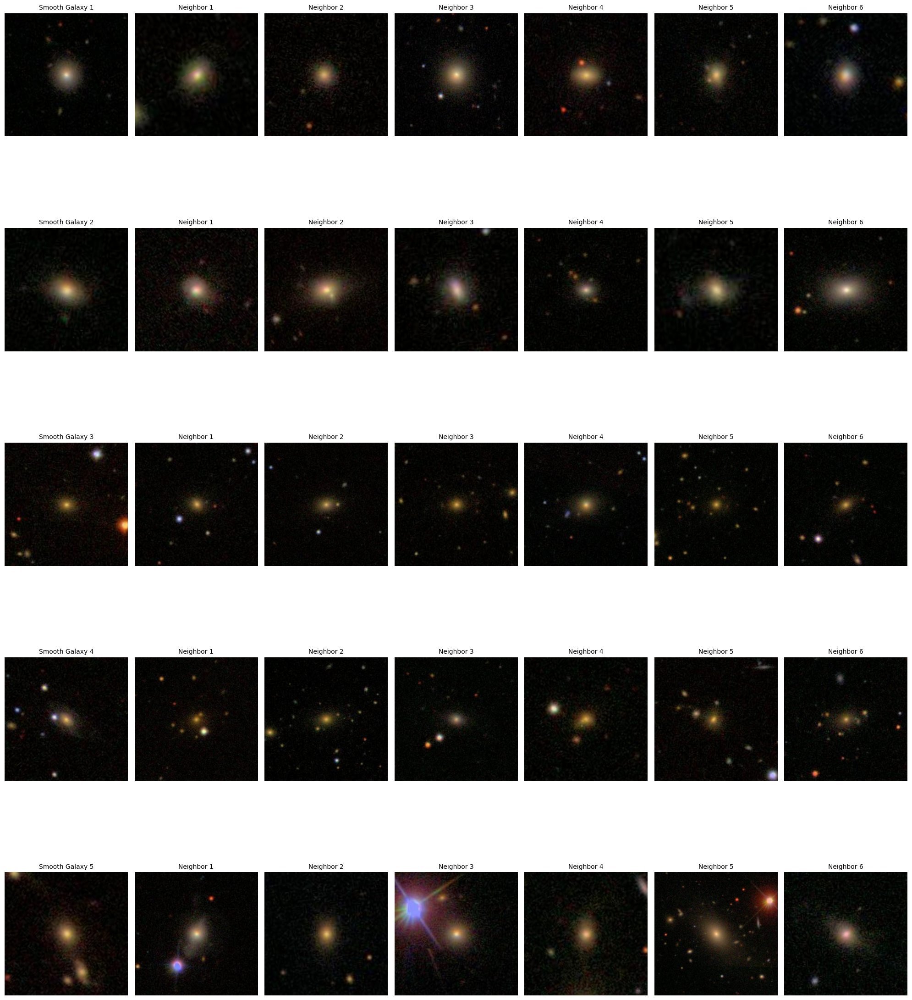

In [296]:

display_selected_galaxies_with_neighbors(umap_reducer.embedding_, X_test, DATA, [10239, 1740, 383, 11845, 4328])

In [263]:
from sklearn.metrics.pairwise import euclidean_distances

C:\Users\William\AppData\Local\Temp\ipykernel_110000\3614227382.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '676751.jpg')


Text(0.5, 1.0, 'Farthest neighbour')

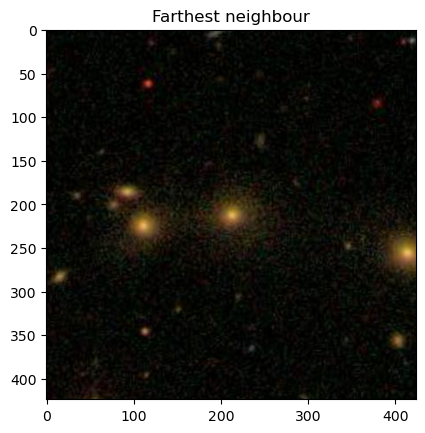

In [72]:
img = iio.imread(DATA + '676751.jpg')
plt.imshow(img)
plt.title("Farthest neighbour")

In [288]:
# do the same for a smooth galaxy
smooth_indices = [i for i, label in enumerate(custom_labels) if label == 'smooth']

In [293]:
random_smooth_index = random.choice(smooth_indices)
random_smooth_index

4328

In [103]:
X_test.iloc[10239]

'376217.png'

C:\Users\William\AppData\Local\Temp\ipykernel_110000\3856436376.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '376217.jpg')


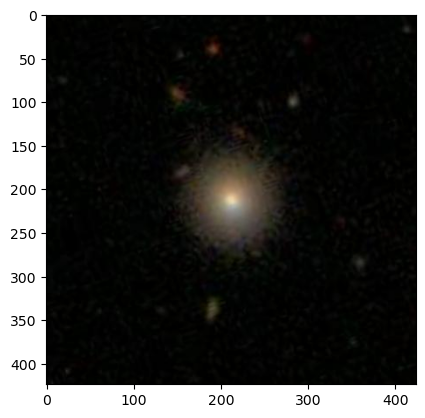

In [104]:
img = iio.imread(DATA + '376217.jpg')
plt.imshow(img)

In [97]:
smooth_point = umap_reducer.embedding_[random_smooth_index]

In [98]:
distances = np.linalg.norm(umap_reducer.embedding_ - smooth_point, axis = 1)

In [99]:
nearest_neighbor_index = np.argmin(distances[distances > 0])  # Skipping self-distance (0)
farthest_neighbor_index = np.argmax(distances)

In [100]:
nearest_label = custom_labels[nearest_neighbor_index]
nearest_coords = umap_reducer.embedding_[nearest_neighbor_index]
farthest_label = custom_labels[farthest_neighbor_index]
farthest_coords = umap_reducer.embedding_[farthest_neighbor_index]

In [102]:
nearest_label

'smooth'

In [105]:
nearest_neighbor_index

4680

In [106]:
X_test.iloc[4680]

'935511.png'

C:\Users\William\AppData\Local\Temp\ipykernel_110000\3232822020.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '935511.jpg')


Text(0.5, 1.0, 'Nearest neighbour')

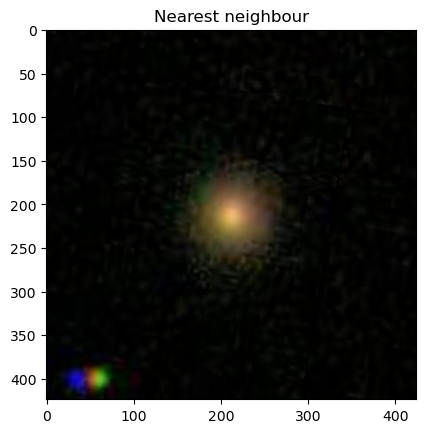

In [108]:
img = iio.imread(DATA + '935511.jpg')
plt.imshow(img)
plt.title("Nearest neighbour")

In [109]:
farthest_neighbor_index

8314

In [110]:
X_test.iloc[8314]

'799861.png'

C:\Users\William\AppData\Local\Temp\ipykernel_110000\841320210.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '799861.jpg')


Text(0.5, 1.0, 'Farthest neighbour')

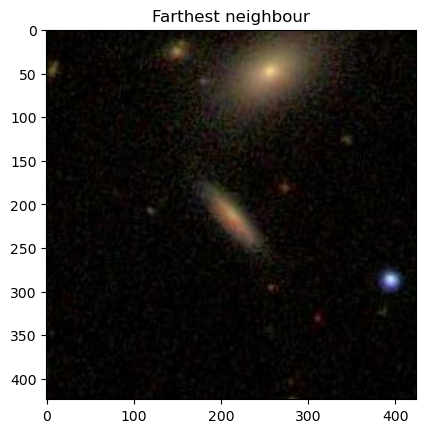

In [111]:
img = iio.imread(DATA + '799861.jpg')
plt.imshow(img)
plt.title("Farthest neighbour")

In [114]:
y_test

array([[0.018765  , 0.95509   , 0.026146  , ..., 0.        , 0.        ,
        0.10738139],
       [0.806705  , 0.14038   , 0.052915  , ..., 0.        , 0.        ,
        0.        ],
       [0.662354  , 0.337646  , 0.        , ..., 0.        , 0.        ,
        0.04410138],
       ...,
       [0.540807  , 0.439755  , 0.019437  , ..., 0.        , 0.        ,
        0.        ],
       [0.367352  , 0.615882  , 0.016766  , ..., 0.        , 0.        ,
        0.2119674 ],
       [0.147845  , 0.838105  , 0.01405   , ..., 0.        , 0.        ,
        0.        ]])

In [138]:
# we get a ring galaxy
ring_index = np.argmax(y_test[:, 23])
X_test.iloc[ring_index]

'647440.png'

C:\Users\William\AppData\Local\Temp\ipykernel_110000\486996370.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = iio.imread(DATA + '647440.jpg')


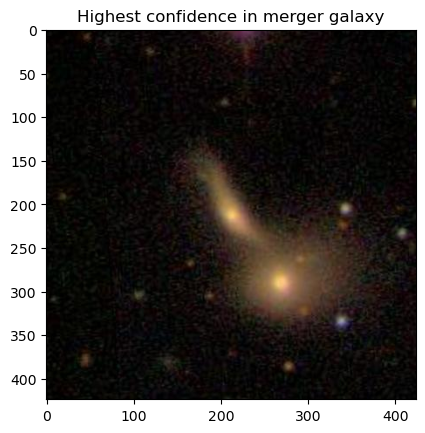

In [140]:
img = iio.imread(DATA + '647440.jpg')
plt.title("Highest confidence in merger galaxy")
plt.imshow(img)

In [141]:
ring_point = umap_reducer.embedding_[ring_index]
ring_point

array([ 4.997634 , -1.6843508], dtype=float32)

In [142]:
distances = np.linalg.norm(umap_reducer.embedding_ - ring_point, axis = 1)
nearest_neighbor_indices = np.argsort(distances)[1:4]
farthest_neighbor_index = np.argmax(distances)

nearest_neighbor_indices,farthest_neighbor_index

(array([10402,  1344,   542], dtype=int64), 281)

In [143]:
X_test.iloc[10402], X_test.iloc[1344], X_test.iloc[542], X_test.iloc[281]

('653327.png', '135039.png', '434730.png', '264534.png')

C:\Users\William\AppData\Local\Temp\ipykernel_110000\1717760389.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = iio.imread(DATA + '653327.jpg')
C:\Users\William\AppData\Local\Temp\ipykernel_110000\1717760389.py:2: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = iio.imread(DATA + '135039.jpg')
C:\Users\William\AppData\Local\Temp\ipykernel_110000\1717760389.py:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio`

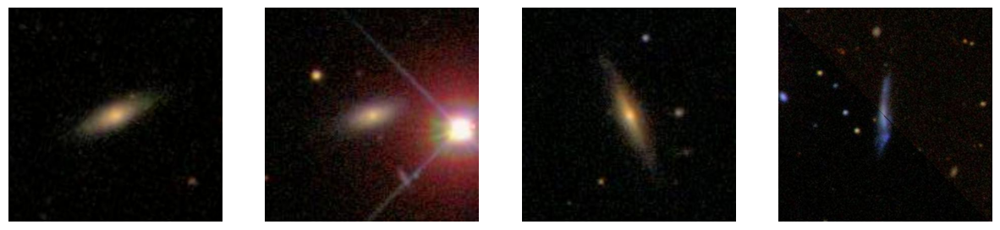

In [144]:
img1 = iio.imread(DATA + '653327.jpg')
img2 = iio.imread(DATA + '135039.jpg')
img3 = iio.imread(DATA + '434730.jpg')
img4 = iio.imread(DATA + '264534.jpg')

images = [img1, img2, img3, img4]

fig, axes = plt.subplots(1, len(images), figsize = (15,5))
for ax, img in zip(axes, images):
    ax.imshow(img)
    ax.axis('off')
    

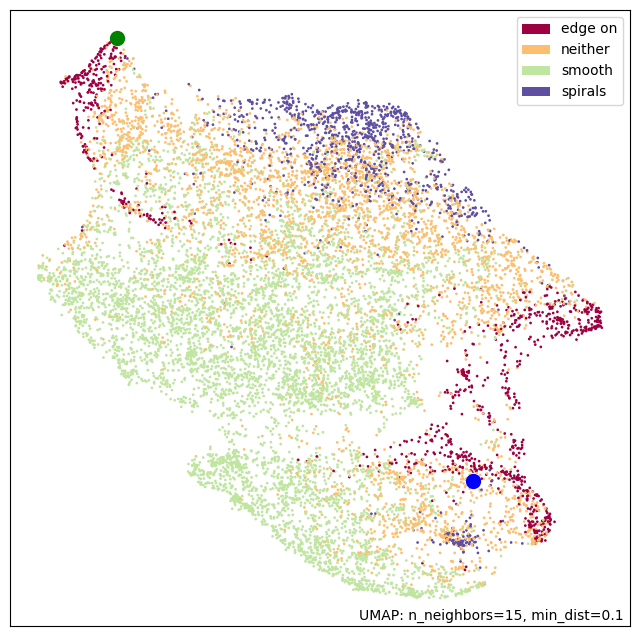

In [147]:
umap.plot.points(umap_reducer, labels = np.array(custom_labels))
plt.scatter(*ring_point, color = "blue", label = "ring", s = 100)
plt.scatter(*umap_reducer.embedding_[farthest_neighbor_index], color = "green", s = 100)